# **Importing packages**

In [1]:
import os
import keras
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tqdm import tqdm
from keras.utils import to_categorical
import tensorflow as tf
from tensorflow.keras.utils import to_categorical
from tqdm import tqdm
from sklearn.utils import resample
from sklearn.metrics import ConfusionMatrixDisplay
from tensorflow.keras import backend as K
from tensorflow.keras import layers
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPool2D , Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras import Model
import cv2
from tensorflow.keras.preprocessing.image import load_img, img_to_array

import warnings
warnings.filterwarnings("ignore")

2024-05-22 06:01:44.700644: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-05-22 06:01:44.700742: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-05-22 06:01:44.979415: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


## Helper functions

In [9]:
def getListOfFiles(dirName):
    listOfFile = os.listdir(dirName)
    allFiles = list()
    for entry in listOfFile:
        fullPath = os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles = allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

# Computing Sensitivity      
def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())

# Computing Specificity
def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1-y_true) * (1-y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1-y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

def load_images(dataframe, image_size, num_classes):
    images = []
    labels = []
    for idx in tqdm(range(dataframe.shape[0])):
        # Load and preprocess the image
        img_path = dataframe.at[idx, 'image']
        img = tf.keras.utils.load_img(img_path, target_size=(image_size, image_size,3))
        img = tf.keras.utils.img_to_array(img)
        img /= 255.0  
        images.append(img)
        label = dataframe.at[idx, 'target']
        encoded_label = to_categorical(label, num_classes=num_classes)
        labels.append(encoded_label)
    x = np.array(images)
    y = np.array(labels).reshape(-1, num_classes)
    return x, y


def data_partition(X, y, test_size=0.3, validation_size=0.5):
    X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=test_size, random_state=42)
    X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=validation_size, random_state=42)
    return X_train, X_test, X_val, y_train, y_test, y_val

In [3]:
class SqueezeExciteBlock(keras.layers.Layer):
    def __init__(self, reduction=16, **kwargs):
        super(SqueezeExciteBlock, self).__init__(**kwargs)
        self.reduction = reduction

    def build(self, input_shape):
        self.global_avg_pool = keras.layers.GlobalAveragePooling2D()
        self.dense1 = keras.layers.Dense(input_shape[-1] // self.reduction, activation='relu', use_bias=False)
        self.dense2 = keras.layers.Dense(input_shape[-1], activation='sigmoid', use_bias=False)
        self.reshape = layers.Reshape((1, 1, input_shape[-1]))
        super(SqueezeExciteBlock, self).build(input_shape)

    def call(self, inputs):
        x = self.global_avg_pool(inputs)
        x = self.dense1(x)
        x = self.dense2(x)
        x = self.reshape(x)
        x = layers.Multiply()([inputs, x])
        return x

    def compute_output_shape(self, input_shape):
        return input_shape

## Importing the data

In [4]:
# Importing the images...
malignant_MC_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/mucinous_carcinoma')
malignant_LC_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/lobular_carcinoma')
malignant_DC_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/ductal_carcinoma')
malignant_PC_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/malignant/SOB/papillary_carcinoma')
benign_A_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis')
benign_F_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/fibroadenoma')
benign_PT_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/phyllodes_tumor')
benign_TA_images = getListOfFiles('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/tubular_adenoma')

In [5]:
# Making sure that we have all the dataset...
print('Number of Mucinous Carcinoma samples: ', len(malignant_MC_images))
print('Number of Lobular Carcinoma samples: ', len(malignant_LC_images))
print('Number of Ductal Carcinoma samples: ', len(malignant_DC_images))
print('Number of Papillary Carcinoma samples: ', len(malignant_PC_images))
print('Number of Adenosis samples: ', len(benign_A_images))
print('Number of Fibroadenoma samples: ', len(benign_F_images))
print('Number of Phyllodes Tumor samples: ', len(benign_PT_images))
print('Number of Tubular Adenoma samples: ', len(benign_TA_images))
print('Total number of malignant samples: ', len(malignant_MC_images) + len(malignant_LC_images) + len(malignant_DC_images) + len(malignant_PC_images))
print('Total number of benign samples: ', len(benign_A_images) + len(benign_F_images) + len(benign_PT_images) + len(benign_TA_images))
total = len(malignant_MC_images) + len(malignant_LC_images) + len(malignant_DC_images) + len(malignant_PC_images) + len(benign_A_images) + len(benign_F_images) + len(benign_PT_images) + len(benign_TA_images)
print('Total number of samples: ', total)

Number of Mucinous Carcinoma samples:  792
Number of Lobular Carcinoma samples:  626
Number of Ductal Carcinoma samples:  3451
Number of Papillary Carcinoma samples:  560
Number of Adenosis samples:  444
Number of Fibroadenoma samples:  1014
Number of Phyllodes Tumor samples:  453
Number of Tubular Adenoma samples:  569
Total number of malignant samples:  5429
Total number of benign samples:  2480
Total number of samples:  7909


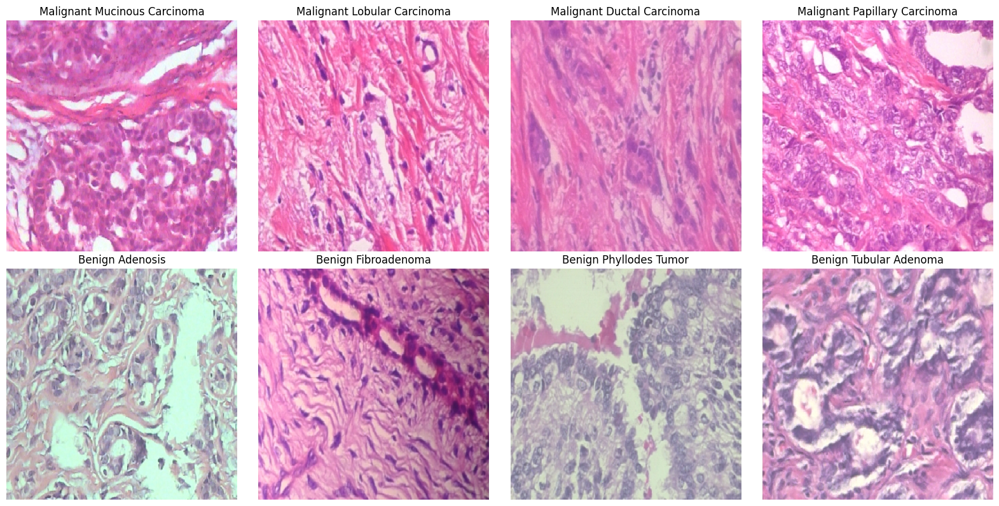

In [6]:
# Showing snippet of the data...
image_sets = [(malignant_MC_images, "Malignant Mucinous Carcinoma"), (malignant_LC_images, "Malignant Lobular Carcinoma"), (malignant_DC_images, "Malignant Ductal Carcinoma"), (malignant_PC_images, "Malignant Papillary Carcinoma"), (benign_A_images, "Benign Adenosis"), (benign_F_images, "Benign Fibroadenoma"), (benign_PT_images, "Benign Phyllodes Tumor"), (benign_TA_images, "Benign Tubular Adenoma")]
size= 260
fig, axes = plt.subplots(2, 4, figsize=(16, 8))  
for ax, (image_list, label) in zip(axes.flatten(), image_sets):
    if image_list:  # Check if there's an image available
        img = tf.keras.utils.load_img(image_list[0], target_size=(size, size)) 
        ax.imshow(img)
        ax.set_title(label)
    ax.axis('off')
plt.tight_layout()
plt.show()

## For subtype classification

In [7]:
# creating "data" variable which is a dataframe containing two columns: "image" for storing the image paths and "target" for storing the labels.
type_images = [malignant_MC_images, malignant_LC_images, malignant_DC_images, malignant_PC_images, benign_A_images, benign_F_images, benign_PT_images, benign_TA_images]
data = pd.DataFrame(index=np.arange(0, total), columns=["image", "target"])
k = 0
for type_index in range(8):
    # For each image path in the list of images for the current type
    for image_path in type_images[type_index]:
        data.at[k, "image"] = image_path
        data.at[k, "target"] = type_index
        k += 1
print(data.shape)
num_classes=8

(7909, 2)


In [9]:
data

,image,target
0,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
1,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
2,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
3,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
4,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
...,...,...
7904,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7
7905,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7
7906,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7
7907,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7


In [10]:
count_data = data["target"].value_counts()
count_data

target
2    3451
5    1014
0     792
1     626
7     569
3     560
6     453
4     444
Name: count, dtype: int64

# Data pre-processing

## Beginning of downsampling code (for use with classification of subtypes)

In [13]:
min_samples = data["target"].value_counts().min()
min_samples

444

In [14]:
# Calculate the minimum number of samples per class
min_samples = data["target"].value_counts().min()

# Downsample the dataframe
data_downsampled = data.groupby("target").apply(lambda x: x.sample(min_samples)).reset_index(drop=True)

# Print the number of samples per class to verify
print(data_downsampled["target"].value_counts())


target
0    444
1    444
2    444
3    444
4    444
5    444
6    444
7    444
Name: count, dtype: int64


In [15]:
data_downsampled

,image,target
0,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
1,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
2,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
3,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
4,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,0
...,...,...
3547,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7
3548,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7
3549,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7
3550,../input/breakhis/BreaKHis_v1/BreaKHis_v1/hist...,7


In [16]:
print('Total number of images after downsampling all classes: ', data_downsampled.shape[0])

Total number of images after downsampling all classes:  3552


### End of data downsampling code

In [10]:
x, y = load_images(data, size, data.iloc[:, -1].nunique())

100%|██████████| 7909/7909 [03:27<00:00, 38.06it/s]


In [11]:
X_train, X_test, X_val, y_train, y_test, y_val = data_partition(x,y)

In [12]:
print('Train dataframe size: ', X_train.shape[0])
print('Validation dataframe size: ', X_val.shape[0])
print('Test dataframe size: ', X_test.shape[0])

Train dataframe size:  5536
Validation dataframe size:  1187
Test dataframe size:  1186


## Beginning of data augmentation code

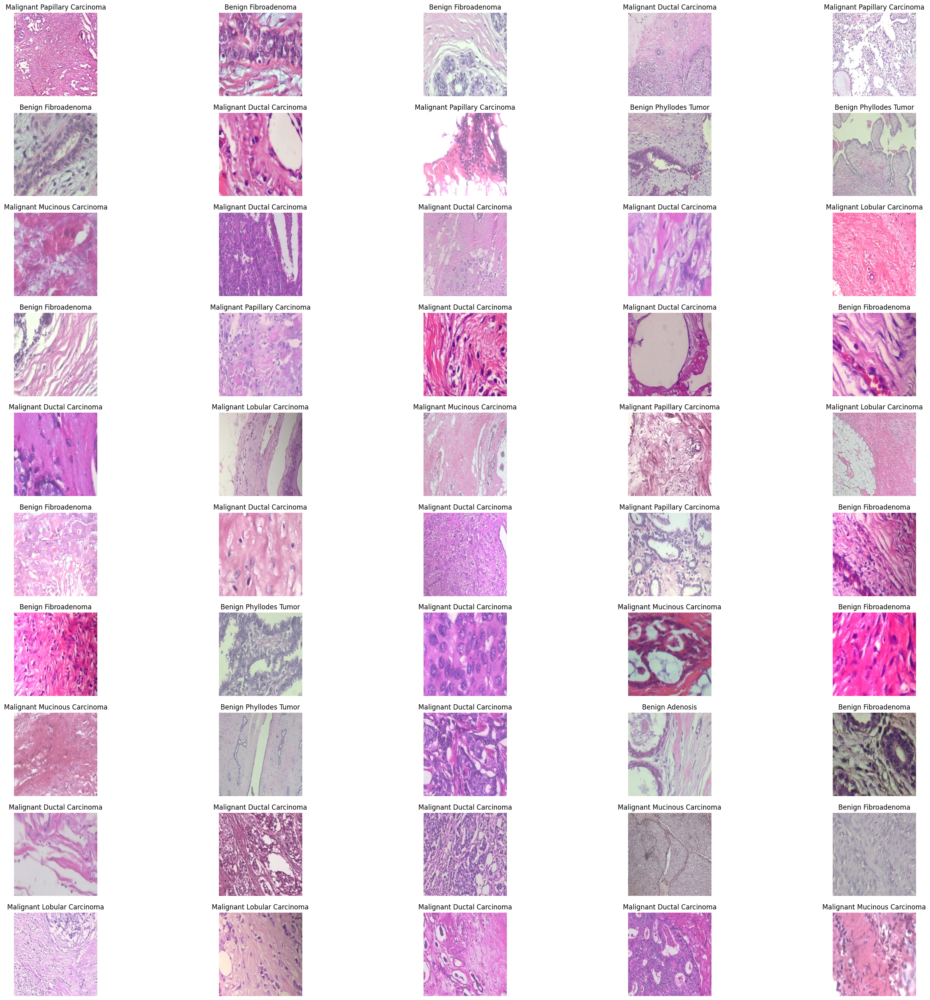

In [11]:
classes = {0:"Malignant Mucinous Carcinoma", 1:"Malignant Lobular Carcinoma", 2:"Malignant Ductal Carcinoma", 3:"Malignant Papillary Carcinoma", 4:"Benign Adenosis",
           5:"Benign Fibroadenoma", 6: "Benign Phyllodes Tumor", 7: "Benign Tubular Adenoma"}


indices = np.random.randint(0, X_train.shape[0], size=50)
images = X_train[indices]
labels = y_train[indices]


plt.figure(figsize=(32, 32))
for i in range(len(indices)):
    plt.subplot(10, 5, i + 1)
    image = images[i]
    plt.imshow(image)  #Display data as an image
    key=labels[i].argmax()
    plt.title(classes[key])
    plt.axis('off')

plt.show()

In [12]:
data_gen = ImageDataGenerator(
        horizontal_flip=True,  # randomly flip images
        vertical_flip=True,  # randomly flip images
    )

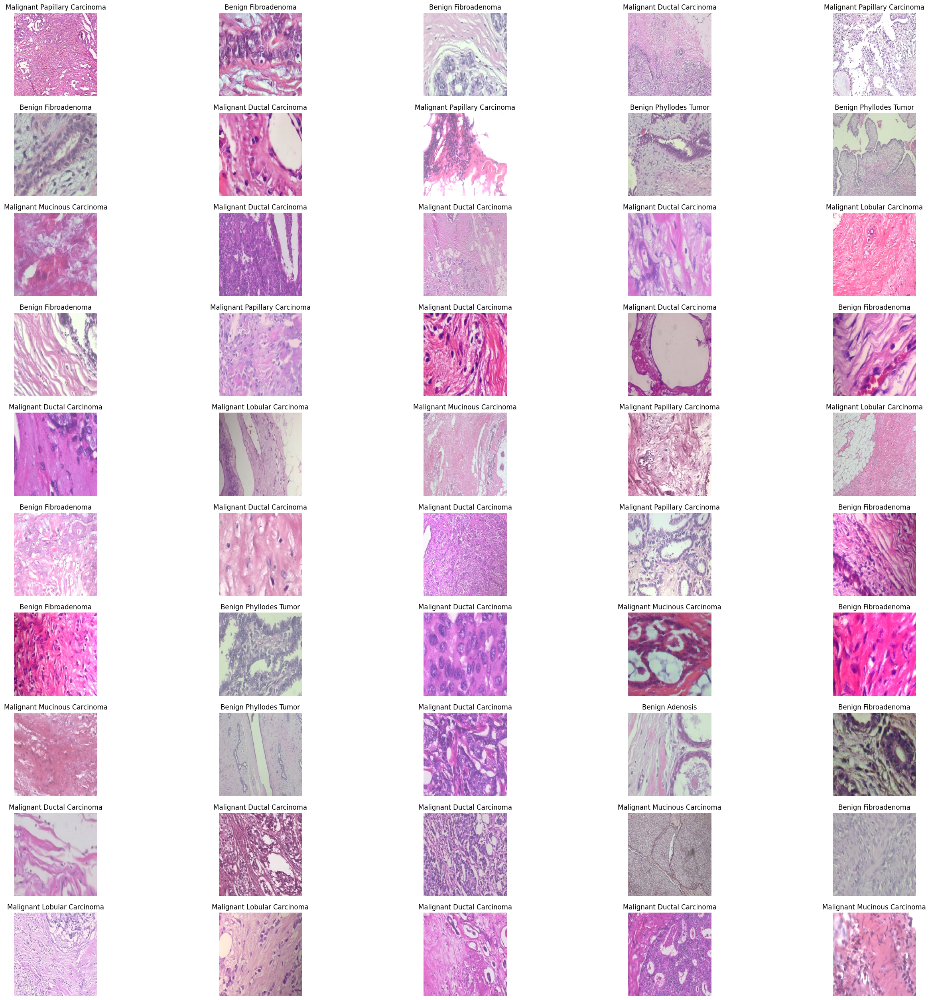

In [13]:
images = X_train[indices]
labels = y_train[indices]
plt.figure(figsize=(32, 32))
for i in range(len(indices)):
    plt.subplot(10, 5, i + 1)
    augmented_image = data_gen.random_transform(images[i])
    plt.imshow(augmented_image)
    key=labels[i].argmax()
    plt.title(classes[key])
    plt.axis('off')

plt.show()

## End of data augmentation code

# Training models

## ResNet

In [13]:
def create_ResNet_without_attention():
    ResNet_base_model.trainable = False

    ResNet_inputs = keras.Input(shape=(260, 260, 3))
    ResNet_features = ResNet_base_model(ResNet_inputs, training=False)
    
    ResNet_features = keras.layers.GlobalAveragePooling2D()(ResNet_features)
    ResNet_outputs = keras.layers.Dense(8, activation='softmax')(ResNet_features)
    
    ResNet_model = keras.Model(inputs=ResNet_inputs, outputs=ResNet_outputs)

    return ResNet_model

In [14]:
def create_ResNet_with_attention():
    ResNet_base_model.trainable = False

    ResNet_inputs = keras.Input(shape=(260, 260, 3))
    ResNet_features = ResNet_base_model(ResNet_inputs, training=False)
    
    attention_layer = SqueezeExciteBlock()
    attention_output = attention_layer(ResNet_features)
    
    ResNet_features = keras.layers.GlobalAveragePooling2D()(attention_output)
    ResNet_outputs = keras.layers.Dense(8, activation='softmax')(ResNet_features)
    
    ResNet_model = keras.Model(inputs=ResNet_inputs, outputs=ResNet_outputs)

    return ResNet_model

In [15]:
 # Callbacks
earlystop = keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1, restore_best_weights=True)
reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, verbose=1, min_delta=0.0001)
csv_logger = keras.callbacks.CSVLogger('model_training.log')
callbacks = [earlystop, reduce_lr, csv_logger]

ResNet_base_model =tf.keras.applications.ResNet50(include_top=False,weights='imagenet',input_shape=(260,260,3))

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


### Training without attention

In [16]:
ResNet_model = create_ResNet_without_attention()
ResNet_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 260, 260, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50 (Functional)           │ (None, 9, 9, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 8)              │        16,392 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,604,104 (90.04 MB)

 Trainable params: 16,392 (64.03 KB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [17]:
 ResNet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                               loss=tf.keras.losses.CategoricalCrossentropy(),
                               metrics=[tf.keras.metrics.CategoricalAccuracy(),
                                        tf.keras.metrics.Precision(),
                                        tf.keras.metrics.Recall(),
                                        tf.keras.metrics.AUC()])
ResNet_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16, callbacks=callbacks)

Epoch 1/50
  1/346 ━━━━━━━━━━━━━━━━━━━━ 1:45:08 18s/step - auc: 0.3552 - categorical_accuracy: 0.0000e+00 - loss: 2.5419 - precision: 0.0000e+00 - recall: 0.0000e+00

I0000 00:00:1716358123.093280     154 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
W0000 00:00:1716358123.150249     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - auc: 0.7024 - categorical_accuracy: 0.4270 - loss: 1.8333 - precision: 0.4595 - recall: 0.1087

W0000 00:00:1716358151.249250     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1716358160.605700     155 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 56s 109ms/step - auc: 0.7025 - categorical_accuracy: 0.4270 - loss: 1.8332 - precision: 0.4595 - recall: 0.1087 - val_auc: 0.7284 - val_categorical_accuracy: 0.4238 - val_loss: 1.7897 - val_precision: 0.4426 - val_recall: 0.1980 - learning_rate: 0.0010
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 28s 80ms/step - auc: 0.7322 - categorical_accuracy: 0.4381 - loss: 1.7685 - precision: 0.4689 - recall: 0.1525 - val_auc: 0.7243 - val_categorical_accuracy: 0.4271 - val_loss: 1.7856 - val_precision: 1.0000 - val_recall: 0.0034 - learning_rate: 0.0010
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 41s 81ms/step - auc: 0.7430 - categorical_accuracy: 0.4384 - loss: 1.7358 - precision: 0.5492 - recall: 0.1247 - val_auc: 0.7149 - val_categorical_accuracy: 0.4238 - val_loss: 1.8545 - val_precision: 0.4913 - val_recall: 0.1668 - learning_rate: 0.0010
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 28s 82ms/step - auc: 0.7524 - categorical_accuracy: 0.4501 - loss: 1.7136 - precision: 0.5408 

In [18]:
# Unfreeze the base model for fine-tuning
ResNet_base_model.trainable = True

# Recompile the model with a very low learning rate
ResNet_model.compile(
    optimizer=keras.optimizers.Adam(1e-5),  # Very low learning rate
    loss=keras.losses.CategoricalCrossentropy(),  # Suitable for multi-class with one-hot encoded labels
    metrics=[
        keras.metrics.CategoricalAccuracy(),
        keras.metrics.Precision(),
        keras.metrics.Recall(),
        keras.metrics.AUC()])

In [19]:
# Adjust the epochs and monitor the training process closely to avoid overfitting
history_ResNet = ResNet_model.fit(
    X_train, y_train, 
    validation_data=(X_val, y_val), 
    epochs=25,  
    batch_size=16, 
    callbacks=callbacks)

Epoch 1/25


W0000 00:00:1716359661.763394     156 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step - auc_1: 0.6898 - categorical_accuracy: 0.3917 - loss: 15.2952 - precision_1: 0.4129 - recall_1: 0.3373

W0000 00:00:1716359745.448467     153 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 162s 262ms/step - auc_1: 0.6899 - categorical_accuracy: 0.3918 - loss: 15.2715 - precision_1: 0.4131 - recall_1: 0.3372 - val_auc_1: 0.6707 - val_categorical_accuracy: 0.4238 - val_loss: 168.0253 - val_precision_1: 0.4238 - val_recall_1: 0.4238 - learning_rate: 1.0000e-05
Epoch 2/25


W0000 00:00:1716359752.320093     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 82s 238ms/step - auc_1: 0.8298 - categorical_accuracy: 0.5218 - loss: 1.4885 - precision_1: 0.6758 - recall_1: 0.3063 - val_auc_1: 0.6676 - val_categorical_accuracy: 0.4238 - val_loss: 63.4844 - val_precision_1: 0.4233 - val_recall_1: 0.4229 - learning_rate: 1.0000e-05
Epoch 3/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 82s 237ms/step - auc_1: 0.8900 - categorical_accuracy: 0.5820 - loss: 1.2291 - precision_1: 0.7469 - recall_1: 0.3969 - val_auc_1: 0.7862 - val_categorical_accuracy: 0.4558 - val_loss: 2.1946 - val_precision_1: 0.5147 - val_recall_1: 0.4128 - learning_rate: 1.0000e-05
Epoch 4/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 82s 238ms/step - auc_1: 0.9251 - categorical_accuracy: 0.6285 - loss: 1.0366 - precision_1: 0.7850 - recall_1: 0.4872 - val_auc_1: 0.9289 - val_categorical_accuracy: 0.6529 - val_loss: 1.0914 - val_precision_1: 0.7564 - val_recall_1: 0.5442 - learning_rate: 1.0000e-05
Epoch 5/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 82s 237ms/step - auc_1: 0.9483 - categorica

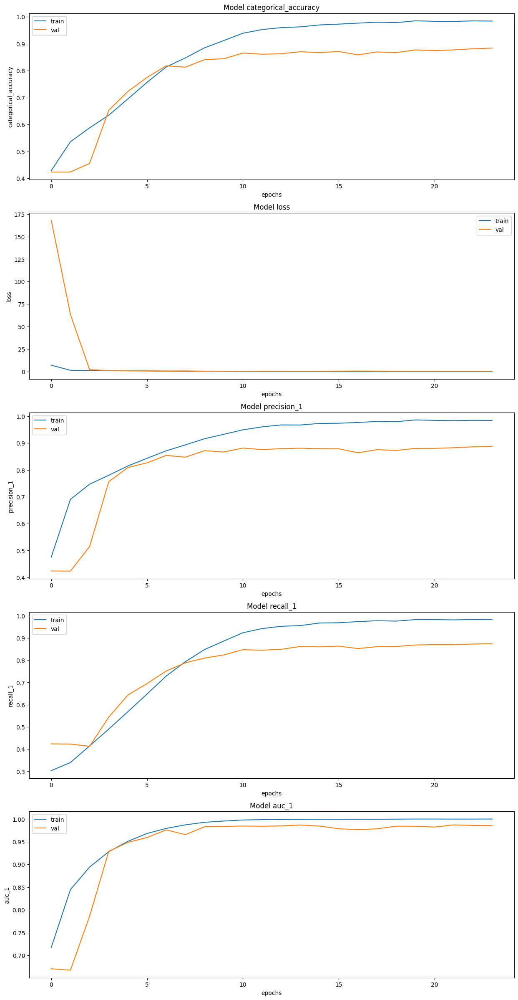

In [20]:
# Interpreting the Metrics
fig, ax = plt.subplots(5, 1, figsize=(15, 30))
ax = ax.ravel()

for i, met in enumerate(['categorical_accuracy','loss','precision_1','recall_1','auc_1']):
    ax[i].plot(history_ResNet.history[met])
    ax[i].plot(history_ResNet.history['val_' + met])
    ax[i].set_title('Model {}'.format(met))
    ax[i].set_xlabel('epochs')
    ax[i].set_ylabel(met)
    ax[i].legend(['train', 'val'])

In [21]:
# Initialize lists for true and predicted labels
y_true = []
y_pred = []

# Model predictions
yhat = ResNet_model.predict(X_test)

# Convert predictions and true labels from one-hot encoding to class indices
y_pred = np.argmax(yhat, axis=1).tolist()
y_true = np.argmax(y_test, axis=1).tolist()

# Calculate accuracy
correct_predictions = sum(p == t for p, t in zip(y_pred, y_true))
acc = (correct_predictions / len(y_true)) * 100

print(f"Accuracy on test set: {acc:.2f}%")

 2/38 ━━━━━━━━━━━━━━━━━━━━ 3s 87ms/step 

W0000 00:00:1716361769.565721     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


38/38 ━━━━━━━━━━━━━━━━━━━━ 24s 290ms/step
Accuracy on test set: 84.57%


W0000 00:00:1716361780.292106     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


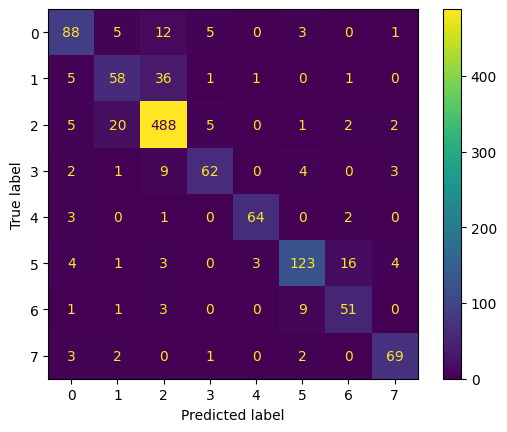

In [22]:
ConfusionMatrixDisplay.from_predictions(y_true, y_pred)

### Training with attention

In [35]:
ResNet_model = create_ResNet_with_attention()
ResNet_model.summary()

Model: "functional_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 260, 260, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ resnet50 (Functional)           │ (None, 9, 9, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ squeeze_excite_block_2          │ (None, 9, 9, 2048)     │             0 │
│ (SqueezeExciteBlock)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_7      │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 8)              │        16,392 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,604,104 (90.04 MB)

 Trainable params: 16,392 (64.03 KB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [36]:
 ResNet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                               loss=tf.keras.losses.CategoricalCrossentropy(),
                               metrics=[tf.keras.metrics.CategoricalAccuracy(),
                                        tf.keras.metrics.Precision(),
                                        tf.keras.metrics.Recall(),
                                        tf.keras.metrics.AUC()])
ResNet_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16, callbacks=callbacks)

Epoch 1/50
  2/346 ━━━━━━━━━━━━━━━━━━━━ 34s 102ms/step - auc_2: 0.4764 - categorical_accuracy: 0.0625 - loss: 2.1188 - precision_2: 0.0000e+00 - recall_2: 0.0000e+00      

W0000 00:00:1716362198.615383     156 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step - auc_2: 0.9362 - categorical_accuracy: 0.7106 - loss: 0.9245 - precision_2: 0.8694 - recall_2: 0.5115

W0000 00:00:1716362228.502909     155 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1716362235.841907     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 50s 109ms/step - auc_2: 0.9363 - categorical_accuracy: 0.7110 - loss: 0.9233 - precision_2: 0.8696 - recall_2: 0.5122 - val_auc_2: 0.9882 - val_categorical_accuracy: 0.8669 - val_loss: 0.4046 - val_precision_2: 0.8974 - val_recall_2: 0.8180 - learning_rate: 0.0010
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 29s 84ms/step - auc_2: 0.9995 - categorical_accuracy: 0.9749 - loss: 0.1258 - precision_2: 0.9804 - recall_2: 0.9658 - val_auc_2: 0.9843 - val_categorical_accuracy: 0.8694 - val_loss: 0.4050 - val_precision_2: 0.8808 - val_recall_2: 0.8467 - learning_rate: 0.0010
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 29s 84ms/step - auc_2: 0.9997 - categorical_accuracy: 0.9804 - loss: 0.0698 - precision_2: 0.9822 - recall_2: 0.9750 - val_auc_2: 0.9839 - val_categorical_accuracy: 0.8846 - val_loss: 0.3943 - val_precision_2: 0.8932 - val_recall_2: 0.8736 - learning_rate: 0.0010
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 29s 83ms/step - auc_2: 0.9998 - categorical_accuracy: 0.98

In [38]:
# Unfreeze the base model for fine-tuning
ResNet_base_model.trainable = True

# Recompile the model with a very low learning rate
ResNet_model.compile(
    optimizer=keras.optimizers.Adam(1e-5),  # Very low learning rate
    loss=keras.losses.CategoricalCrossentropy(),  # Suitable for multi-class with one-hot encoded labels
    metrics=[
        keras.metrics.CategoricalAccuracy(),
        keras.metrics.Precision(),
        keras.metrics.Recall(),
        keras.metrics.AUC()])

In [39]:
# Adjust the epochs and monitor the training process closely to avoid overfitting
history_ResNet = ResNet_model.fit(
    X_train, y_train, 
    validation_data=(X_val, y_val), 
    epochs=25,  
    batch_size=16, 
    callbacks=callbacks)

Epoch 1/25


W0000 00:00:1716362672.226038     155 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step - auc_4: 0.9972 - categorical_accuracy: 0.9432 - loss: 0.1703 - precision_4: 0.9552 - recall_4: 0.9345

W0000 00:00:1716362756.438683     153 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1716362763.496449     155 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 149s 265ms/step - auc_4: 0.9972 - categorical_accuracy: 0.9432 - loss: 0.1703 - precision_4: 0.9552 - recall_4: 0.9345 - val_auc_4: 0.9875 - val_categorical_accuracy: 0.8677 - val_loss: 0.3873 - val_precision_4: 0.8841 - val_recall_4: 0.8610 - learning_rate: 1.0000e-05
Epoch 2/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 82s 238ms/step - auc_4: 0.9991 - categorical_accuracy: 0.9741 - loss: 0.0826 - precision_4: 0.9768 - recall_4: 0.9717 - val_auc_4: 0.9869 - val_categorical_accuracy: 0.8821 - val_loss: 0.3891 - val_precision_4: 0.8871 - val_recall_4: 0.8736 - learning_rate: 1.0000e-05
Epoch 5/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 82s 238ms/step - auc_4: 0.9994 - categorical_accuracy: 0.9707 - loss: 0.0810 - precision_4: 0.9722 - recall_4: 0.9692 - val_auc_4: 0.9842 - val_categorical_accuracy: 0.8787 - val_loss: 0.4273 - val_precision_4: 0.8847 - val_recall_4: 0.8728 - learning_rate: 1.0000e-05
Epoch 6/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 223ms/step - auc_4: 0.9996 - categorical

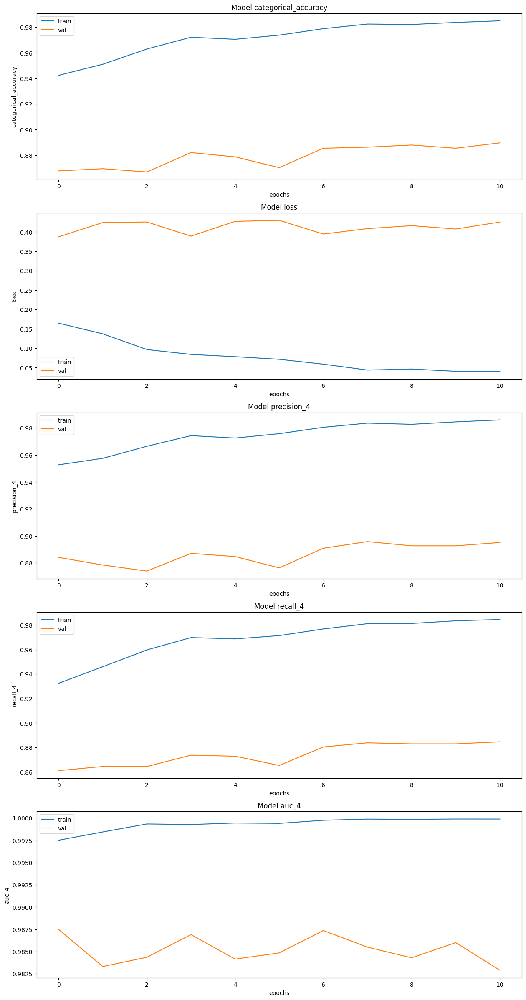

In [40]:
# Interpreting the Metrics
fig, ax = plt.subplots(5, 1, figsize=(15, 30))
ax = ax.ravel()

for i, met in enumerate(['categorical_accuracy','loss','precision_4','recall_4','auc_4']):
    ax[i].plot(history_ResNet.history[met])
    ax[i].plot(history_ResNet.history['val_' + met])
    ax[i].set_title('Model {}'.format(met))
    ax[i].set_xlabel('epochs')
    ax[i].set_ylabel(met)
    ax[i].legend(['train', 'val'])

In [41]:
# Initialize lists for true and predicted labels
y_true = []
y_pred = []

# Model predictions
yhat = ResNet_model.predict(X_test)

# Convert predictions and true labels from one-hot encoding to class indices
y_pred = np.argmax(yhat, axis=1).tolist()
y_true = np.argmax(y_test, axis=1).tolist()

# Calculate accuracy
correct_predictions = sum(p == t for p, t in zip(y_pred, y_true))
acc = (correct_predictions / len(y_true)) * 100

print(f"Accuracy on test set: {acc:.2f}%")

 2/38 ━━━━━━━━━━━━━━━━━━━━ 4s 137ms/step

W0000 00:00:1716363749.457024     154 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


38/38 ━━━━━━━━━━━━━━━━━━━━ 13s 232ms/step
Accuracy on test set: 86.09%


W0000 00:00:1716363758.021392     156 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


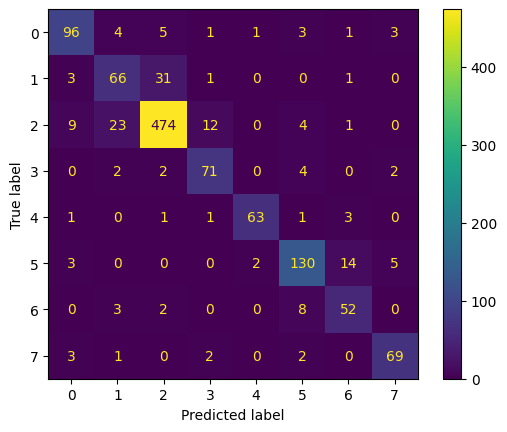

In [42]:
ConfusionMatrixDisplay.from_predictions(y_true, y_pred)

# **EfficientNet**

In [30]:
def create_EfficientNet_without_attention():
    EfficientNet_base_model.trainable = False

    EfficientNet_inputs = keras.Input(shape=(260, 260, 3))
    EfficientNet_features = EfficientNet_base_model(EfficientNet_inputs, training=False)

    EfficientNet_features = keras.layers.GlobalAveragePooling2D()(EfficientNet_features)
    EfficientNet_features = keras.layers.BatchNormalization()(EfficientNet_features)

    EfficientNet_features = Dense(256, activation='relu')(EfficientNet_features)
    EfficientNet_outputs = Dense(8, activation='softmax')(EfficientNet_features)

    EfficientNet_model = Model(inputs=EfficientNet_inputs, outputs=EfficientNet_outputs)

    return EfficientNet_model

In [29]:
def create_EfficientNet_with_attention():
    EfficientNet_base_model.trainable = False

    EfficientNet_inputs = keras.Input(shape=(260, 260, 3))
    EfficientNet_features = EfficientNet_base_model(EfficientNet_inputs, training=False)
    
    attention_layer = SqueezeExciteBlock()
    attention_output = attention_layer(EfficientNet_features)

    EfficientNet_features = keras.layers.GlobalAveragePooling2D()(attention_output)
    EfficientNet_features = keras.layers.BatchNormalization()(EfficientNet_features)

    EfficientNet_features = Dense(256, activation='relu')(EfficientNet_features)
    EfficientNet_outputs = Dense(8, activation='softmax')(EfficientNet_features)

    EfficientNet_model = Model(inputs=EfficientNet_inputs, outputs=EfficientNet_outputs)

    return EfficientNet_model

In [32]:
 # Callbacks
earlystop = keras.callbacks.EarlyStopping(monitor='val_loss', min_delta=0, patience=10, verbose=1, restore_best_weights=True)
reduce_lr = keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, verbose=1, min_delta=0.0001)
csv_logger = keras.callbacks.CSVLogger('model_training.log')
callbacks = [earlystop, reduce_lr, csv_logger]
EfficientNet_base_model = keras.applications.EfficientNetB0(include_top=False, weights='imagenet', input_shape=(260, 260, 3))

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


## Training with attention

In [33]:
EfficientNet_model = create_EfficientNet_with_attention()
EfficientNet_model.summary()

Model: "functional_27"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)      │ (None, 260, 260, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 9, 9, 1280)     │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ squeeze_excite_block_1          │ (None, 9, 9, 1280)     │             0 │
│ (SqueezeExciteBlock)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_4      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 256)            │       327,936 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 8)              │         2,056 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,384,683 (16.73 MB)

 Trainable params: 332,552 (1.27 MB)

 Non-trainable params: 4,052,131 (15.46 MB)

In [18]:
 EfficientNet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                               loss=tf.keras.losses.CategoricalCrossentropy(),
                               metrics=[tf.keras.metrics.CategoricalAccuracy(),
                                        tf.keras.metrics.Precision(),
                                        tf.keras.metrics.Recall(),
                                        tf.keras.metrics.AUC()])
EfficientNet_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16, callbacks=callbacks)

Epoch 1/50
  3/346 ━━━━━━━━━━━━━━━━━━━━ 15s 44ms/step - auc: 0.5716 - categorical_accuracy: 0.1597 - loss: 2.1068 - precision: 0.2500 - recall: 0.0417               

I0000 00:00:1716337315.569885     118 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
W0000 00:00:1716337315.626762     118 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


345/346 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - auc: 0.6828 - categorical_accuracy: 0.3855 - loss: 2.0463 - precision: 0.4443 - recall: 0.1689

W0000 00:00:1716337333.026613     116 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1716337341.940438     118 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 61s 77ms/step - auc: 0.6828 - categorical_accuracy: 0.3855 - loss: 2.0462 - precision: 0.4441 - recall: 0.1687 - val_auc: 0.6805 - val_categorical_accuracy: 0.4238 - val_loss: 2.0162 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0010
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 12s 36ms/step - auc: 0.7031 - categorical_accuracy: 0.4118 - loss: 1.8734 - precision: 0.4392 - recall: 0.1201 - val_auc: 0.7271 - val_categorical_accuracy: 0.4238 - val_loss: 1.9525 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0010
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 12s 36ms/step - auc: 0.6971 - categorical_accuracy: 0.4286 - loss: 1.8485 - precision: 0.4370 - recall: 0.0983 - val_auc: 0.7289 - val_categorical_accuracy: 0.4238 - val_loss: 1.8756 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0010
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 13s 36ms/step - auc: 0.7136 - categorical_accuracy: 0.4459 - loss: 1.79

In [19]:
# Unfreeze the base model for fine-tuning
EfficientNet_base_model.trainable = True

# Recompile the model with a very low learning rate
EfficientNet_model.compile(
    optimizer=keras.optimizers.Adam(1e-5),  # Very low learning rate
    loss=keras.losses.CategoricalCrossentropy(),  # Suitable for multi-class with one-hot encoded labels
    metrics=[
        keras.metrics.CategoricalAccuracy(),
        keras.metrics.Precision(),
        keras.metrics.Recall(),
        keras.metrics.AUC()])

In [20]:
# Adjust the epochs and monitor the training process closely to avoid overfitting
history_EfficientNet = EfficientNet_model.fit(
    X_train, y_train, 
    validation_data=(X_val, y_val), 
    epochs=25,  
    batch_size=16, 
    callbacks=callbacks)

Epoch 1/25
  1/346 ━━━━━━━━━━━━━━━━━━━━ 8:52:50 93s/step - auc_1: 0.7123 - categorical_accuracy: 0.4375 - loss: 1.7988 - precision_1: 1.0000 - recall_1: 0.0625

W0000 00:00:1716337811.115175     116 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step - auc_1: 0.7301 - categorical_accuracy: 0.4217 - loss: 1.7751 - precision_1: 0.6297 - recall_1: 0.0996

W0000 00:00:1716337852.949075     118 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 140s 136ms/step - auc_1: 0.7301 - categorical_accuracy: 0.4218 - loss: 1.7750 - precision_1: 0.6299 - recall_1: 0.0997 - val_auc_1: 0.4806 - val_categorical_accuracy: 0.0977 - val_loss: 557.7066 - val_precision_1: 0.0961 - val_recall_1: 0.0952 - learning_rate: 1.0000e-05
Epoch 2/25


W0000 00:00:1716337858.063381     115 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 37s 106ms/step - auc_1: 0.8086 - categorical_accuracy: 0.5020 - loss: 1.5435 - precision_1: 0.7281 - recall_1: 0.2340 - val_auc_1: 0.7026 - val_categorical_accuracy: 0.3976 - val_loss: 3.2836 - val_precision_1: 0.4298 - val_recall_1: 0.2502 - learning_rate: 1.0000e-05
Epoch 3/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 37s 108ms/step - auc_1: 0.8499 - categorical_accuracy: 0.5457 - loss: 1.4056 - precision_1: 0.7320 - recall_1: 0.3207 - val_auc_1: 0.8510 - val_categorical_accuracy: 0.5392 - val_loss: 1.3933 - val_precision_1: 0.6923 - val_recall_1: 0.3791 - learning_rate: 1.0000e-05
Epoch 4/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 37s 107ms/step - auc_1: 0.8797 - categorical_accuracy: 0.5790 - loss: 1.2849 - precision_1: 0.7388 - recall_1: 0.3958 - val_auc_1: 0.8933 - val_categorical_accuracy: 0.5813 - val_loss: 1.2289 - val_precision_1: 0.7338 - val_recall_1: 0.4389 - learning_rate: 1.0000e-05
Epoch 5/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 37s 106ms/step - auc_1: 0.9028 - categorical

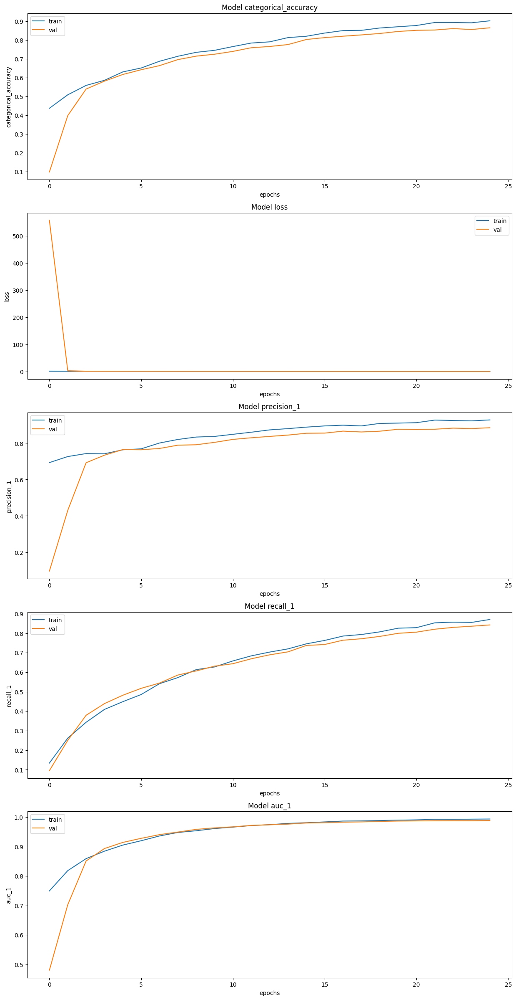

In [21]:
# Interpreting the Metrics
fig, ax = plt.subplots(5, 1, figsize=(15, 30))
ax = ax.ravel()

for i, met in enumerate(['categorical_accuracy','loss','precision_1','recall_1','auc_1']):
    ax[i].plot(history_EfficientNet.history[met])
    ax[i].plot(history_EfficientNet.history['val_' + met])
    ax[i].set_title('Model {}'.format(met))
    ax[i].set_xlabel('epochs')
    ax[i].set_ylabel(met)
    ax[i].legend(['train', 'val'])

In [23]:
# Initialize lists for true and predicted labels
y_true = []
y_pred = []

# Model predictions
yhat = EfficientNet_model.predict(X_test)

# Convert predictions and true labels from one-hot encoding to class indices
y_pred = np.argmax(yhat, axis=1).tolist()
y_true = np.argmax(y_test, axis=1).tolist()

# Calculate accuracy
correct_predictions = sum(p == t for p, t in zip(y_pred, y_true))
acc = (correct_predictions / len(y_true)) * 100

print(f"Accuracy on test set: {acc:.2f}%")

 4/38 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step

W0000 00:00:1716338953.131752     115 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


38/38 ━━━━━━━━━━━━━━━━━━━━ 13s 198ms/step
Accuracy on test set: 85.75%


W0000 00:00:1716338960.469252     115 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


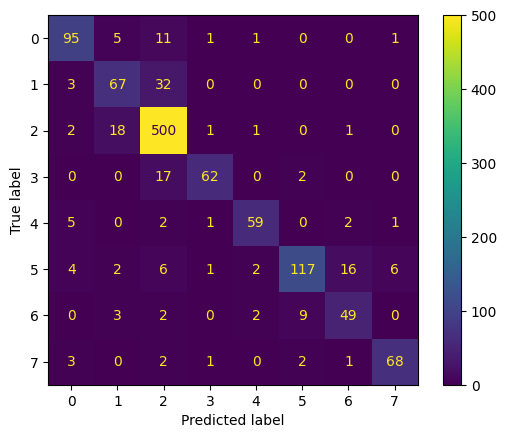

In [24]:
ConfusionMatrixDisplay.from_predictions(y_true, y_pred)

## Training without attention

In [34]:
EfficientNet_model = create_EfficientNet_without_attention()
EfficientNet_model.summary()

Model: "functional_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)      │ (None, 260, 260, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 9, 9, 1280)     │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_5      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 256)            │       327,936 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 8)              │         2,056 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,384,683 (16.73 MB)

 Trainable params: 332,552 (1.27 MB)

 Non-trainable params: 4,052,131 (15.46 MB)

In [14]:
 EfficientNet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                               loss=tf.keras.losses.CategoricalCrossentropy(),
                               metrics=[tf.keras.metrics.CategoricalAccuracy(),
                                        tf.keras.metrics.Precision(),
                                        tf.keras.metrics.Recall(),
                                        tf.keras.metrics.AUC()])
EfficientNet_model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16, callbacks=callbacks)

Epoch 1/50
  3/346 ━━━━━━━━━━━━━━━━━━━━ 15s 45ms/step - auc: 0.5291 - categorical_accuracy: 0.2083 - loss: 2.1322 - precision: 0.0000e+00 - recall: 0.0000e+00   

I0000 00:00:1716341727.531821      92 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
W0000 00:00:1716341727.589704      92 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


345/346 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - auc: 0.6831 - categorical_accuracy: 0.3965 - loss: 1.9001 - precision: 0.4008 - recall: 0.0881

W0000 00:00:1716341745.508951      93 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1716341754.264946      90 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 63s 78ms/step - auc: 0.6832 - categorical_accuracy: 0.3966 - loss: 1.8997 - precision: 0.4009 - recall: 0.0880 - val_auc: 0.7223 - val_categorical_accuracy: 0.4238 - val_loss: 1.7901 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0010
Epoch 2/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 12s 36ms/step - auc: 0.7231 - categorical_accuracy: 0.4540 - loss: 1.7413 - precision: 0.4929 - recall: 0.1040 - val_auc: 0.7098 - val_categorical_accuracy: 0.4238 - val_loss: 1.7908 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 0.0010
Epoch 3/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 12s 36ms/step - auc: 0.7120 - categorical_accuracy: 0.4286 - loss: 1.7805 - precision: 0.3556 - recall: 0.0200 - val_auc: 0.7168 - val_categorical_accuracy: 0.4238 - val_loss: 1.7981 - val_precision: 0.4238 - val_recall: 0.4238 - learning_rate: 0.0010
Epoch 4/50
346/346 ━━━━━━━━━━━━━━━━━━━━ 13s 36ms/step - auc: 0.7153 - categorical_accuracy: 0.4366 - loss: 1.7687 - pre

In [15]:
# Unfreeze the base model for fine-tuning
EfficientNet_base_model.trainable = True

# Recompile the model with a very low learning rate
EfficientNet_model.compile(
    optimizer=keras.optimizers.Adam(1e-5),  # Very low learning rate
    loss=keras.losses.CategoricalCrossentropy(),  # Suitable for multi-class with one-hot encoded labels
    metrics=[
        keras.metrics.CategoricalAccuracy(),
        keras.metrics.Precision(),
        keras.metrics.Recall(),
        keras.metrics.AUC()])

In [16]:
# Adjust the epochs and monitor the training process closely to avoid overfitting
history_EfficientNet = EfficientNet_model.fit(
    X_train, y_train, 
    validation_data=(X_val, y_val), 
    epochs=25,  
    batch_size=16, 
    callbacks=callbacks)

Epoch 1/25
  1/346 ━━━━━━━━━━━━━━━━━━━━ 9:07:11 95s/step - auc_1: 0.6124 - categorical_accuracy: 0.1875 - loss: 2.7643 - precision_1: 0.1667 - recall_1: 0.1250

W0000 00:00:1716342134.492344      91 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step - auc_1: 0.7421 - categorical_accuracy: 0.4288 - loss: 2.0332 - precision_1: 0.5064 - recall_1: 0.3328

W0000 00:00:1716342175.450392      91 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 141s 133ms/step - auc_1: 0.7421 - categorical_accuracy: 0.4289 - loss: 2.0328 - precision_1: 0.5065 - recall_1: 0.3328 - val_auc_1: 0.5410 - val_categorical_accuracy: 0.1896 - val_loss: 163.0463 - val_precision_1: 0.1893 - val_recall_1: 0.1879 - learning_rate: 1.0000e-05
Epoch 2/25


W0000 00:00:1716342180.529547      93 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


346/346 ━━━━━━━━━━━━━━━━━━━━ 36s 104ms/step - auc_1: 0.8216 - categorical_accuracy: 0.5178 - loss: 1.5482 - precision_1: 0.6215 - recall_1: 0.3603 - val_auc_1: 0.6969 - val_categorical_accuracy: 0.3968 - val_loss: 2.8910 - val_precision_1: 0.4216 - val_recall_1: 0.3648 - learning_rate: 1.0000e-05
Epoch 3/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 36s 104ms/step - auc_1: 0.8767 - categorical_accuracy: 0.5584 - loss: 1.2826 - precision_1: 0.7056 - recall_1: 0.4004 - val_auc_1: 0.8848 - val_categorical_accuracy: 0.5762 - val_loss: 1.2478 - val_precision_1: 0.6936 - val_recall_1: 0.4482 - learning_rate: 1.0000e-05
Epoch 4/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 36s 104ms/step - auc_1: 0.9150 - categorical_accuracy: 0.6267 - loss: 1.0863 - precision_1: 0.7454 - recall_1: 0.4531 - val_auc_1: 0.9213 - val_categorical_accuracy: 0.6293 - val_loss: 1.0436 - val_precision_1: 0.7419 - val_recall_1: 0.4987 - learning_rate: 1.0000e-05
Epoch 5/25
346/346 ━━━━━━━━━━━━━━━━━━━━ 36s 104ms/step - auc_1: 0.9266 - categorical

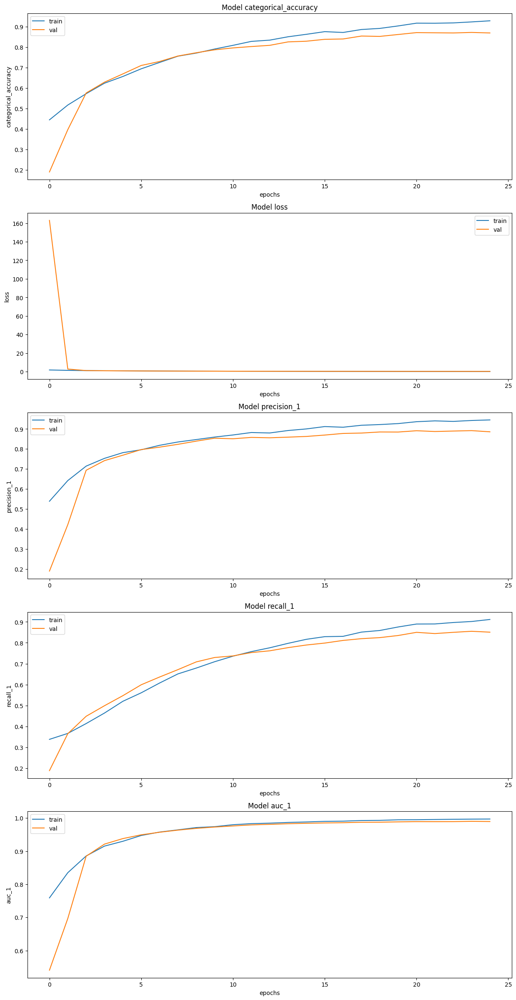

In [18]:
# Interpreting the Metrics
fig, ax = plt.subplots(5, 1, figsize=(15, 30))
ax = ax.ravel()

for i, met in enumerate(['categorical_accuracy','loss','precision_1','recall_1','auc_1']):
    ax[i].plot(history_EfficientNet.history[met])
    ax[i].plot(history_EfficientNet.history['val_' + met])
    ax[i].set_title('Model {}'.format(met))
    ax[i].set_xlabel('epochs')
    ax[i].set_ylabel(met)
    ax[i].legend(['train', 'val'])

In [20]:
# Initialize lists for true and predicted labels
y_true = []
y_pred = []

# Model predictions
yhat = EfficientNet_model.predict(X_test)

# Convert predictions and true labels from one-hot encoding to class indices
y_pred = np.argmax(yhat, axis=1).tolist()
y_true = np.argmax(y_test, axis=1).tolist()

# Calculate accuracy
correct_predictions = sum(p == t for p, t in zip(y_pred, y_true))
acc = (correct_predictions / len(y_true)) * 100

print(f"Accuracy on test set: {acc:.2f}%")

 4/38 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step

W0000 00:00:1716343423.738804      91 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


38/38 ━━━━━━━━━━━━━━━━━━━━ 14s 224ms/step
Accuracy on test set: 84.82%


W0000 00:00:1716343432.019697      90 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


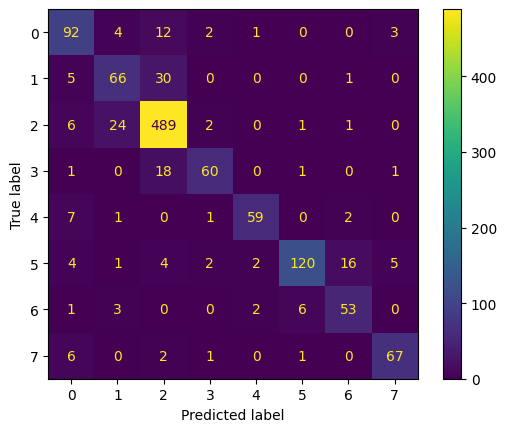

In [21]:
ConfusionMatrixDisplay.from_predictions(y_true, y_pred)

# **Grad-Cam Analysis**

In [23]:
def get_image(path):

    dat = data[data['image'] == path]
    dat = dat.reset_index(drop=True)
    x, y = load_and_preprocess_images(dat, 260, num_classes)
    return (x[0], y)

In [24]:
# Implementation from https://github.com/samson6460/tf_keras_gradcamplusplus/blob/master/gradcam.py


def grad_cam(model, img, label, layer_name='efficientnetb0'):
    """
    Generate a heatmap for a given image and label using Gradient-weighted Class Activation Mapping (Grad-CAM).

    Args:
        model: TensorFlow/Keras model.
        img: Preprocessed image array (matching the input requirements of the model).
        label: One-hot encoded label vector for the image.
        layer_name: Name of the last convolutional layer to target for the Grad-CAM.

    Returns:
        A heatmap array (without color, normalized).
    """
    img_tensor = tf.convert_to_tensor(img, dtype=tf.float32)
    img_tensor = tf.expand_dims(img_tensor, axis=0)

    conv_layer = model.get_layer(layer_name)
    heatmap_model = tf.keras.Model(inputs=model.inputs, outputs=[conv_layer.output, model.output])

    category_id = np.argmax(label)

    # Use GradientTape to compute gradients
    with tf.GradientTape() as gtape:
        gtape.watch(img_tensor)
        conv_outputs, predictions = heatmap_model(img_tensor)
        loss = predictions[:, category_id]

    # Compute gradients of the target class's output with respect to the conv layer's outputs
    grads = gtape.gradient(loss, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    heatmap = tf.reduce_sum(tf.multiply(pooled_grads, conv_outputs), axis=-1)[0]
    heatmap = np.maximum(heatmap, 0)
    max_heat = np.max(heatmap)
    if max_heat == 0:
        max_heat = 1e-10
    heatmap /= max_heat

    return heatmap

In [25]:
# Superimposing the heatmap on the image

def apply_heatmap_to_image(heatmap, original_image, alpha=0.6):
    
    original_image = (original_image * 255).astype('uint8')
    
    # Normalize and resize heatmap
    heatmap = np.uint8(255 * cv2.resize(heatmap, (original_image.shape[1], original_image.shape[0])))

    # Apply a colormap to heatmap
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Superimpose the heatmap on the original image
    superimposed_img = cv2.addWeighted(original_image, 1 - alpha, heatmap, alpha, 0)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
    plt.title('Image with Heatmap')
    plt.axis('off')
    
    plt.show()
    
    # We can also save the plots in addition to or instead of showing them.

### ResNet without attention

100%|██████████| 1/1 [00:00<00:00, 22.20it/s]


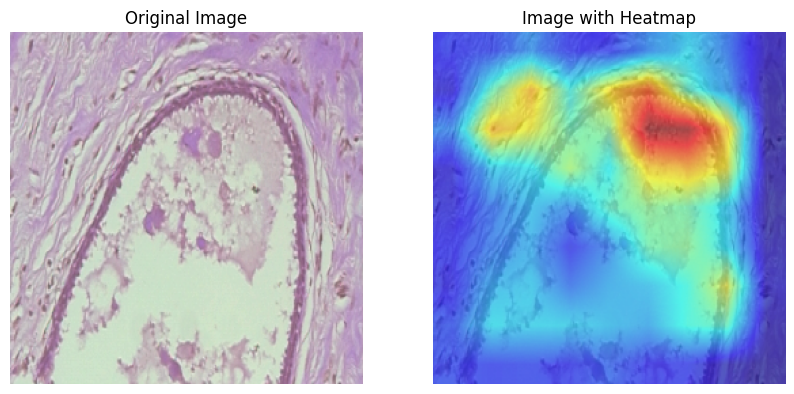

In [26]:
# a simple trial on one of the images for resnet50

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(ResNet_base_model, x, y, layer_name='conv5_block3_out')
apply_heatmap_to_image(heatmap, x)

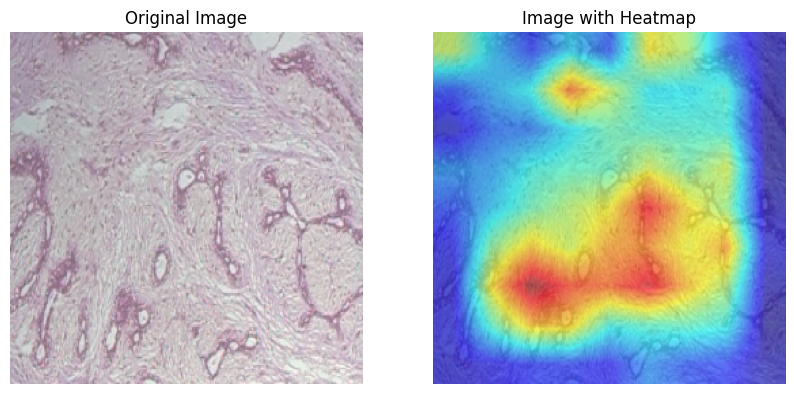

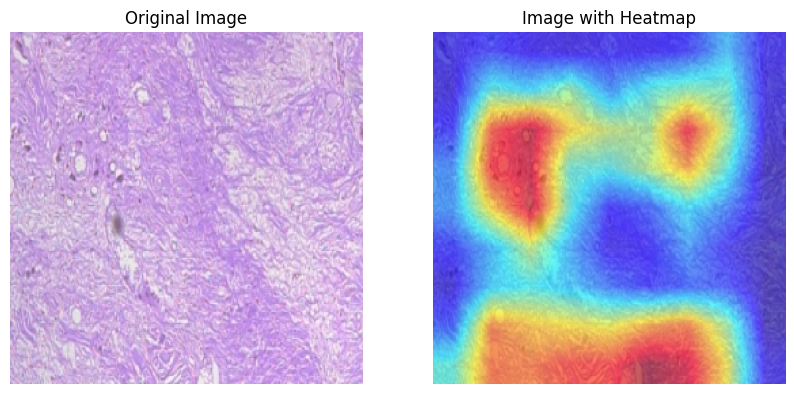

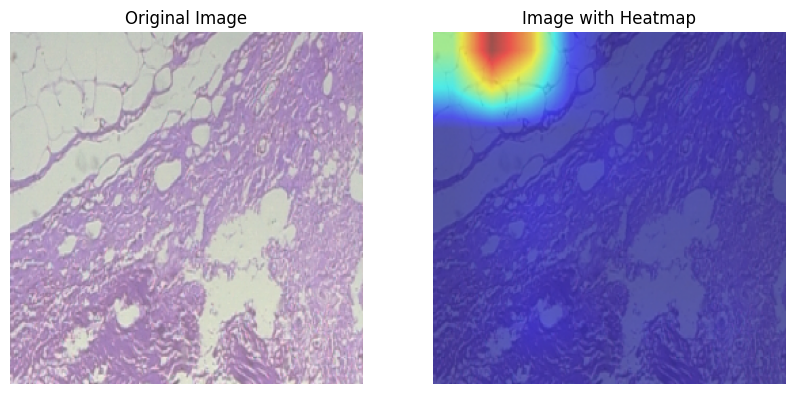

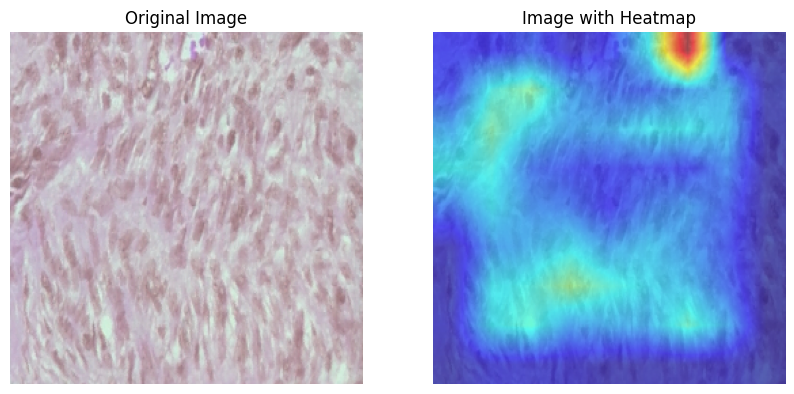

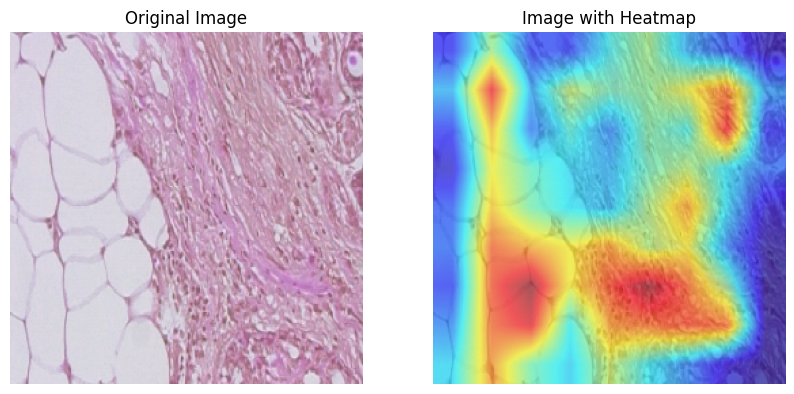

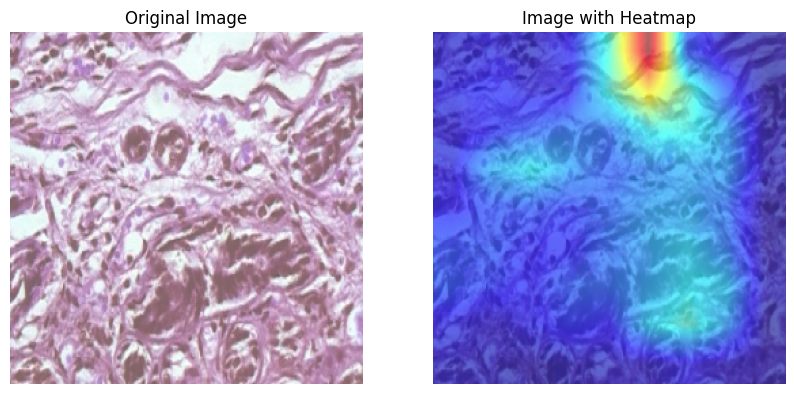

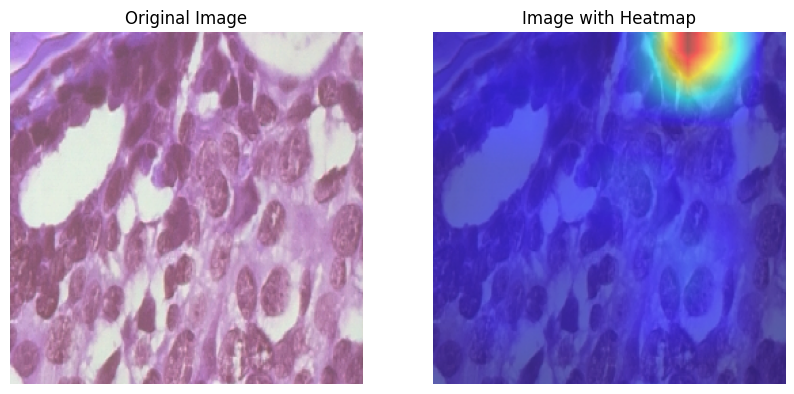

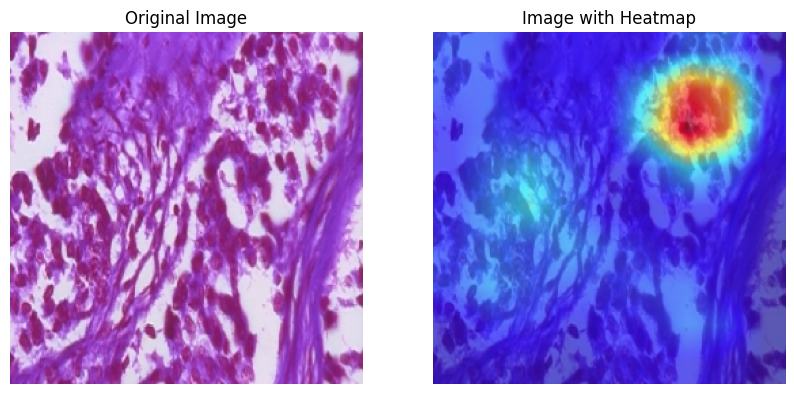

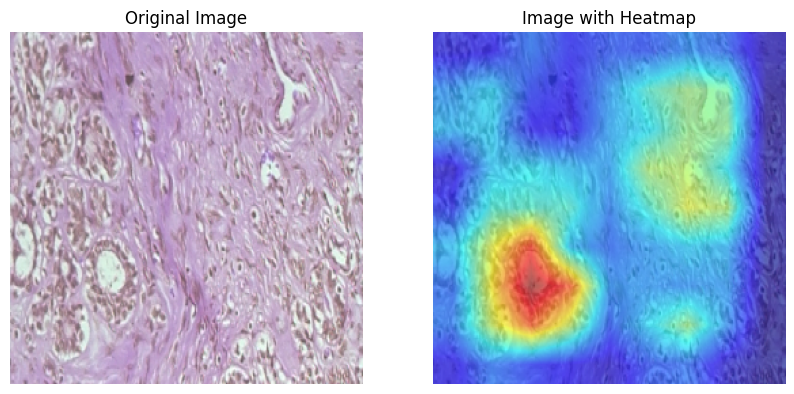

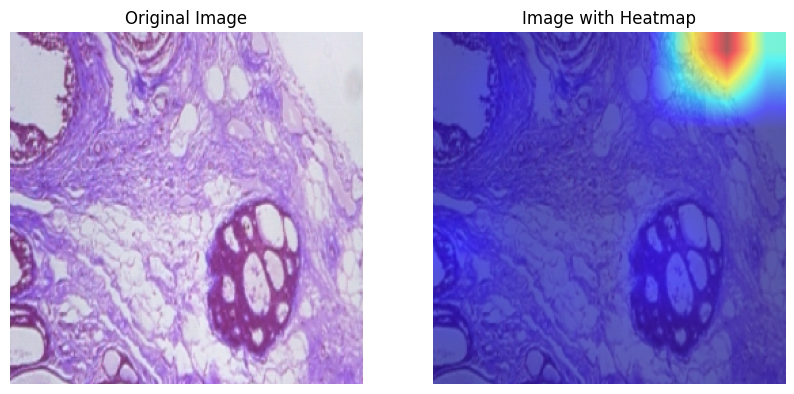

In [27]:
# testing on 10 images

for img, label in zip(X_test[:10], y_test[:10]):

    heatmap = grad_cam(ResNet_base_model, img, label, layer_name='conv5_block3_out')
    apply_heatmap_to_image(heatmap, img)

### ReNet with attention

100%|██████████| 1/1 [00:00<00:00, 32.73it/s]


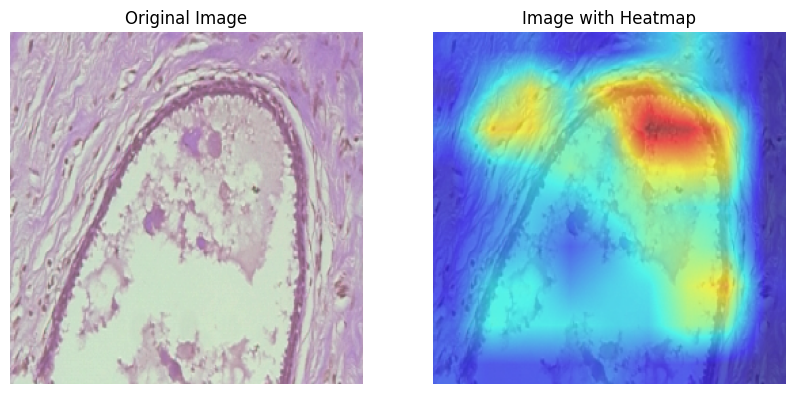

In [43]:
# a simple trial on one of the images for resnet50

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(ResNet_base_model, x, y, layer_name='conv5_block3_out')
apply_heatmap_to_image(heatmap, x)

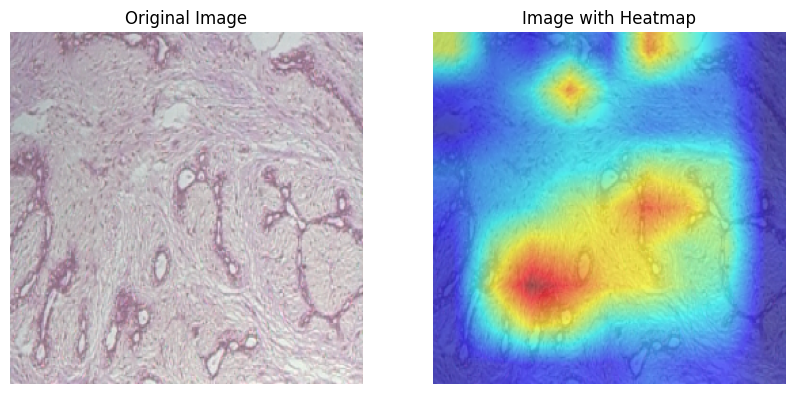

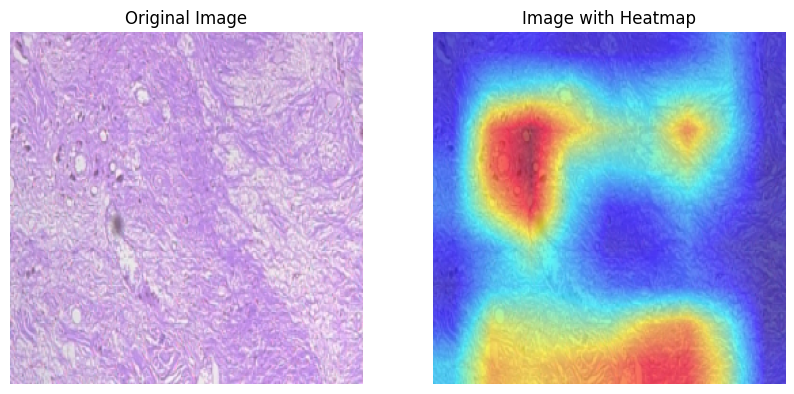

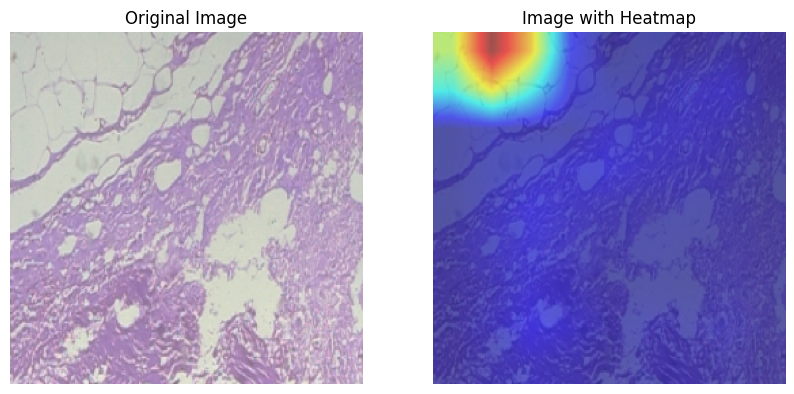

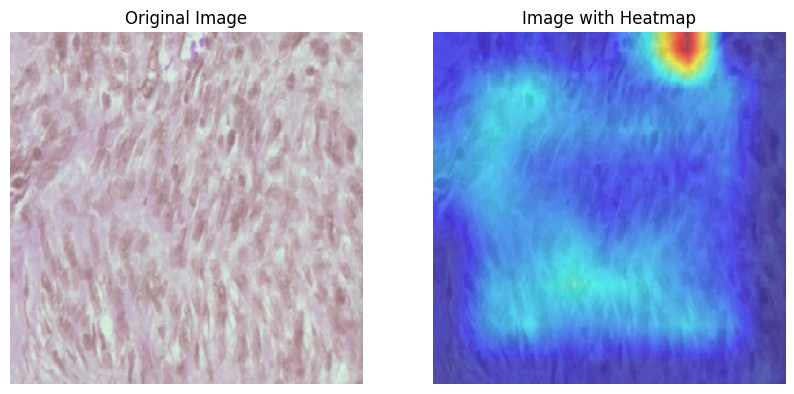

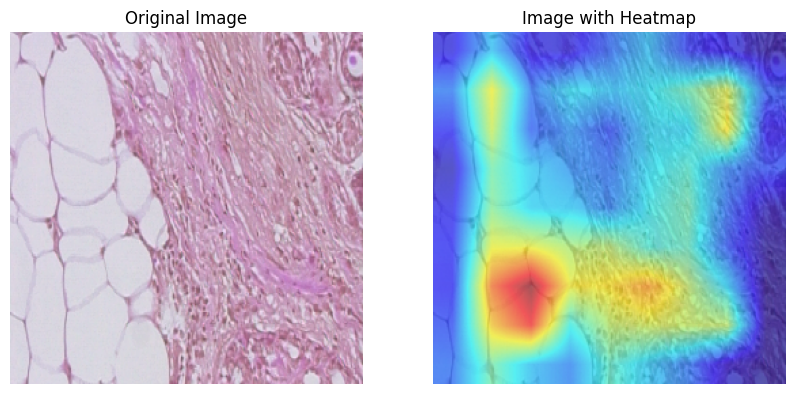

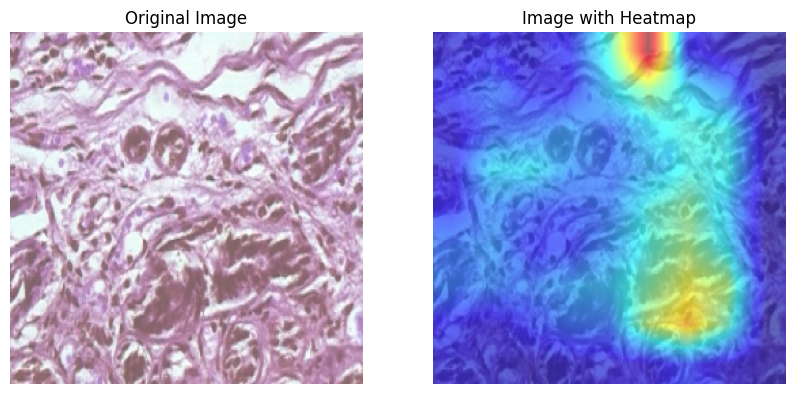

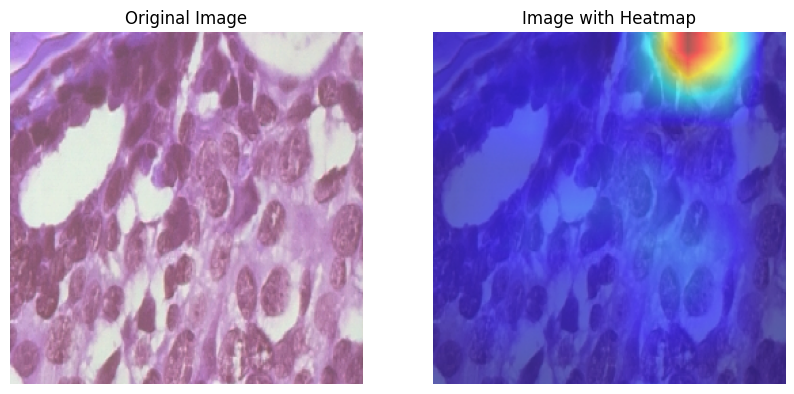

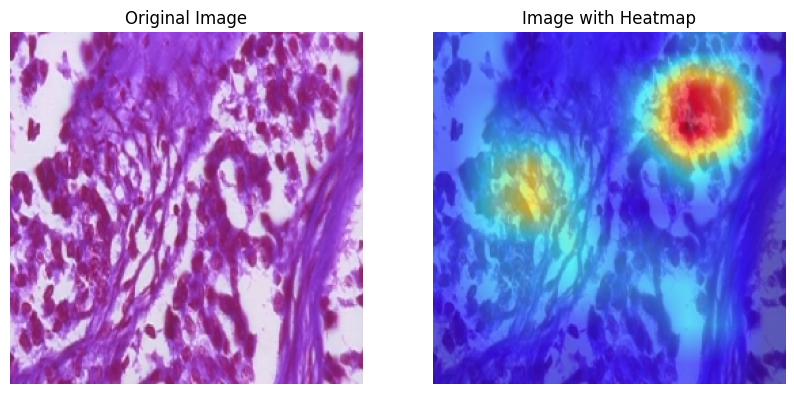

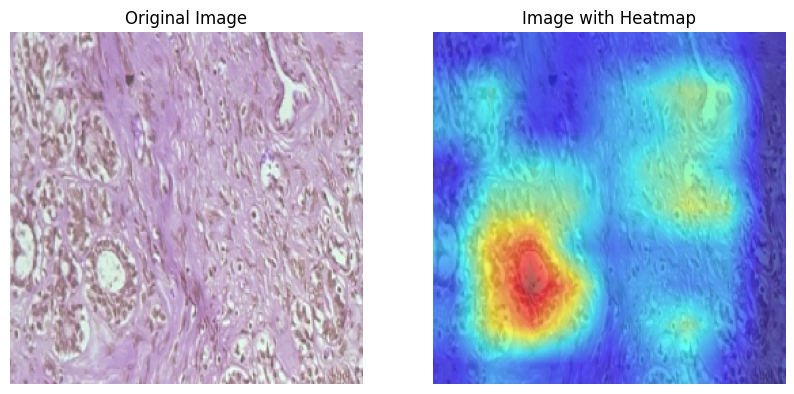

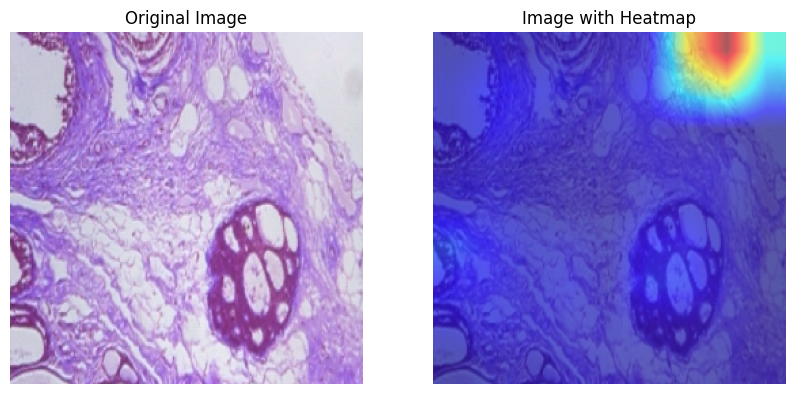

In [44]:
# testing on 10 images

for img, label in zip(X_test[:10], y_test[:10]):

    heatmap = grad_cam(ResNet_base_model, img, label, layer_name='conv5_block3_out')
    apply_heatmap_to_image(heatmap, img)

### EfficientNet without attention

100%|██████████| 1/1 [00:00<00:00, 16.75it/s]


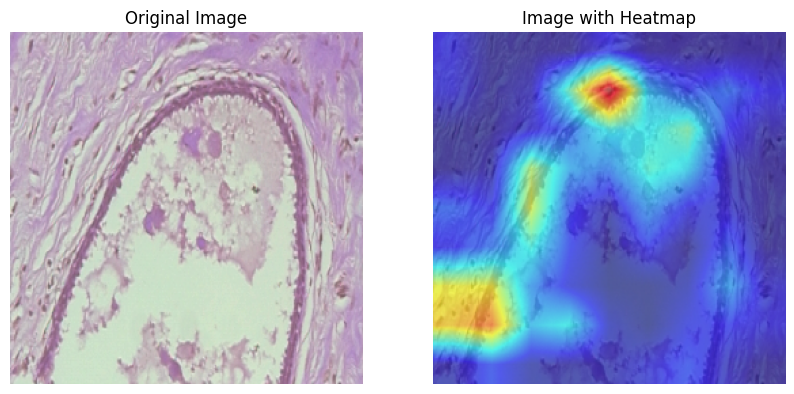

In [28]:
# a simple trial on one of the images without attention

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(EfficientNet_base_model, x, y, layer_name='top_activation')
apply_heatmap_to_image(heatmap, x)

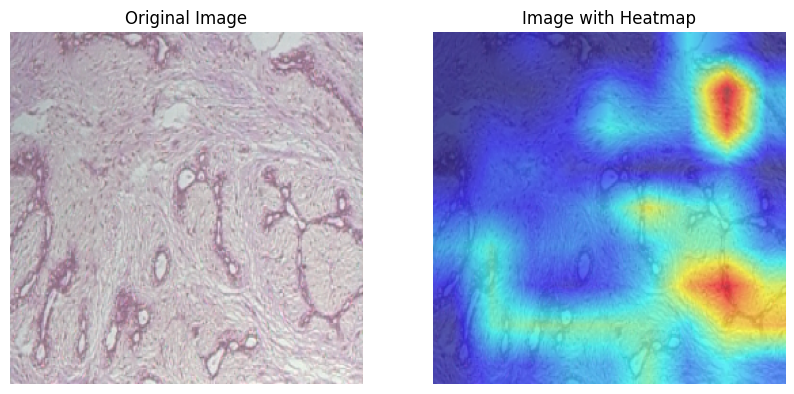

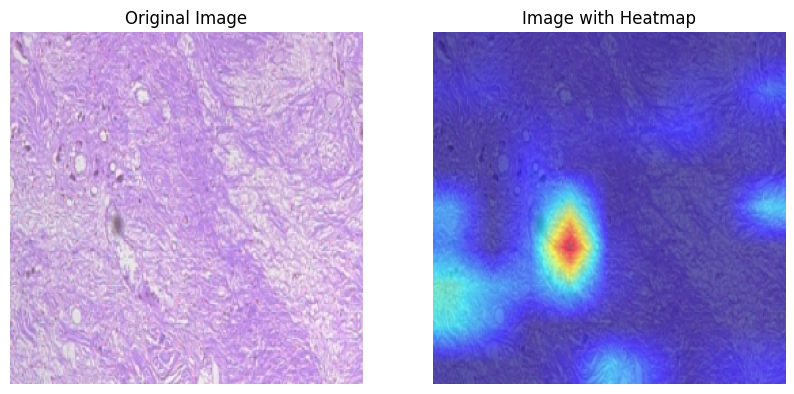

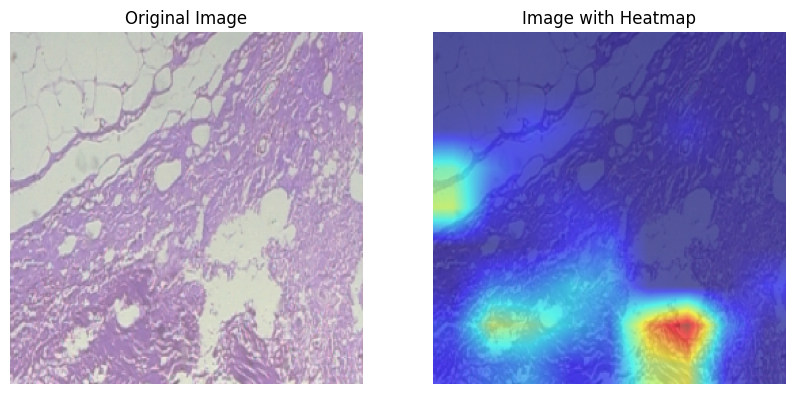

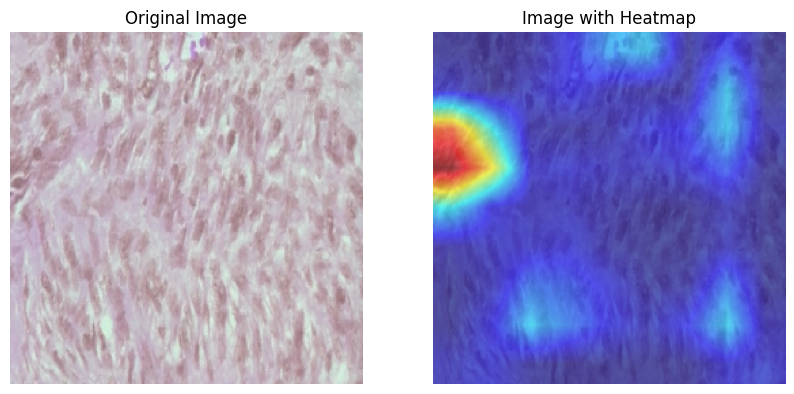

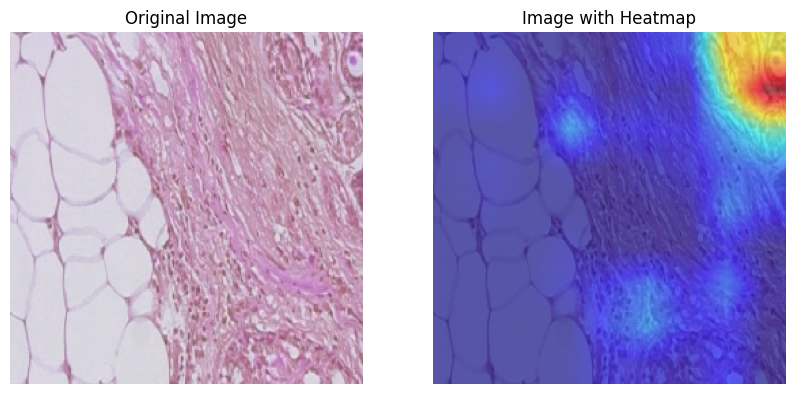

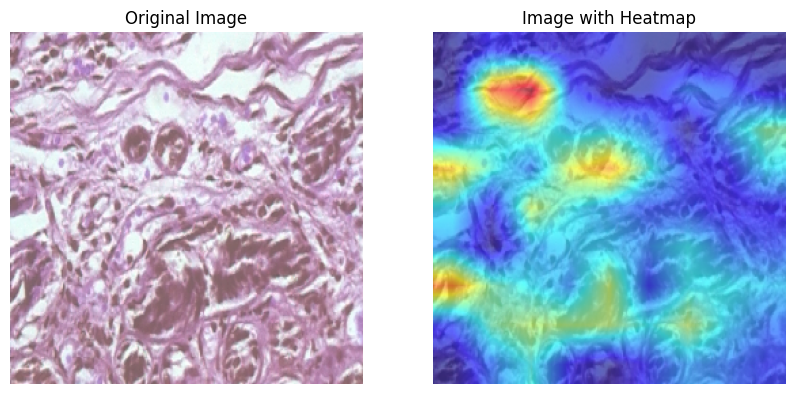

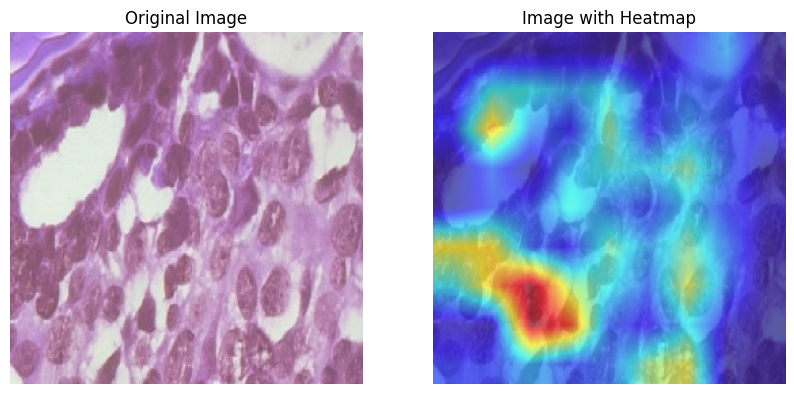

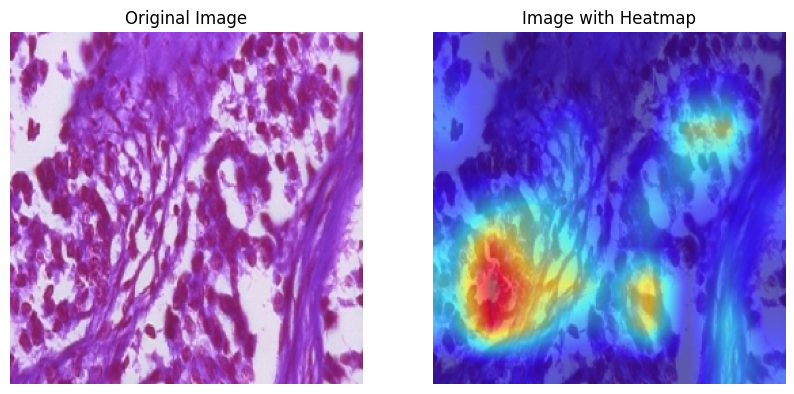

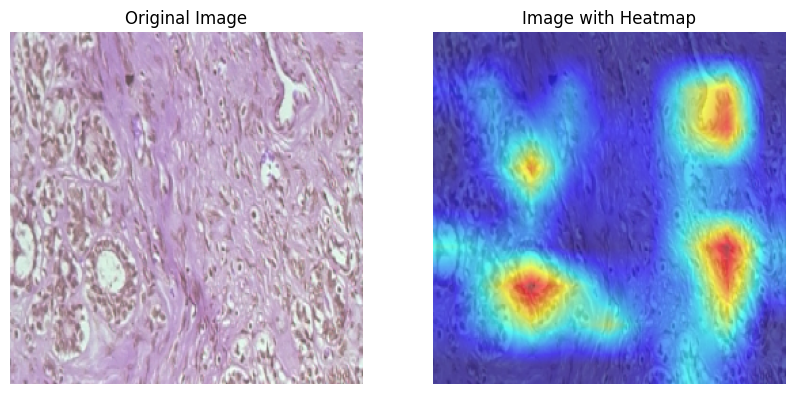

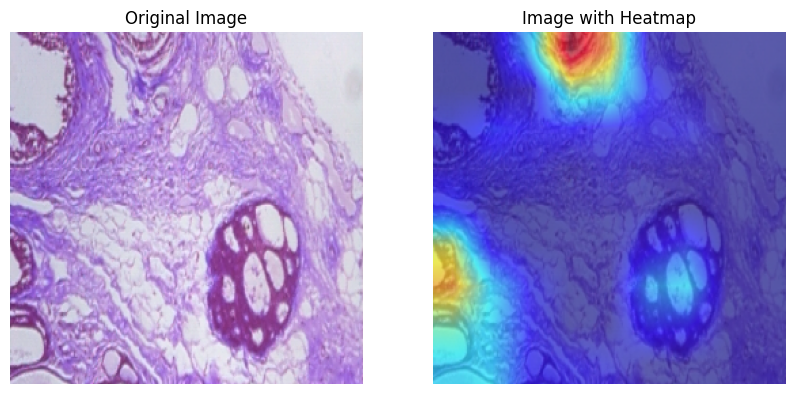

In [29]:
# without attention

for img, label in zip(X_test[:10], y_test[:10]):

    heatmap = grad_cam(EfficientNet_base_model, img, label, layer_name='top_activation')
    apply_heatmap_to_image(heatmap, img)

### EfficientNet with attention

100%|██████████| 1/1 [00:00<00:00, 29.69it/s]


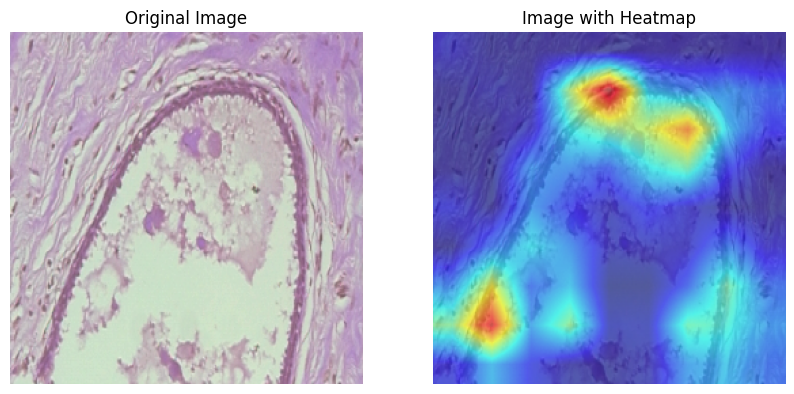

In [25]:
# a simple trial on one of the images with attention

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(EfficientNet_base_model, x, y, layer_name='top_activation')
apply_heatmap_to_image(heatmap, x)

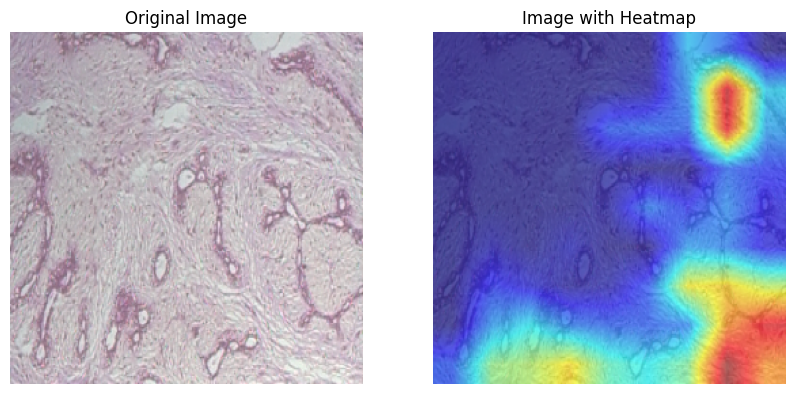

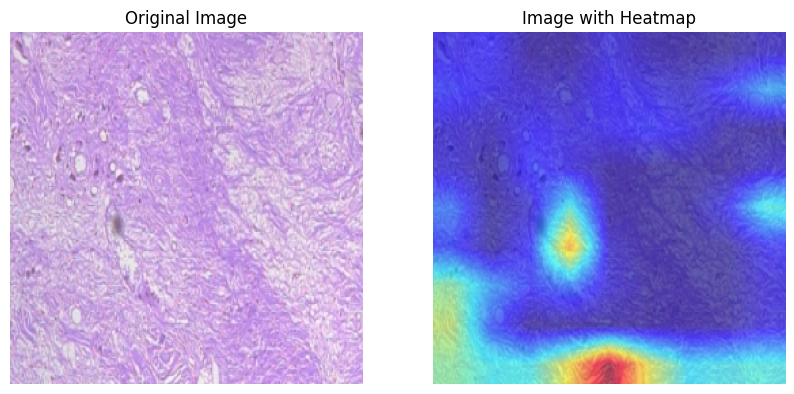

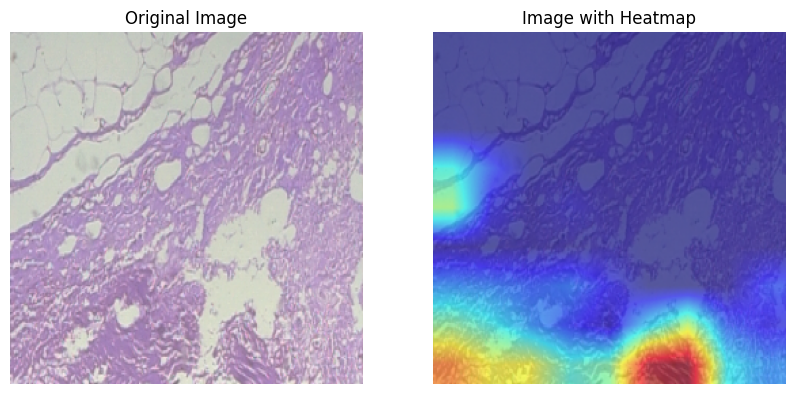

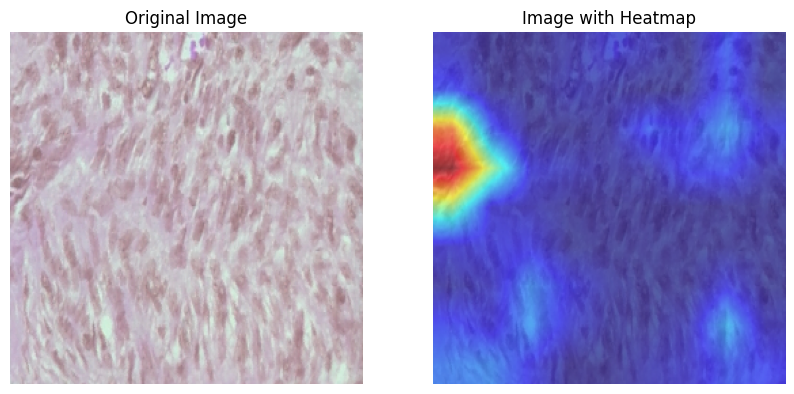

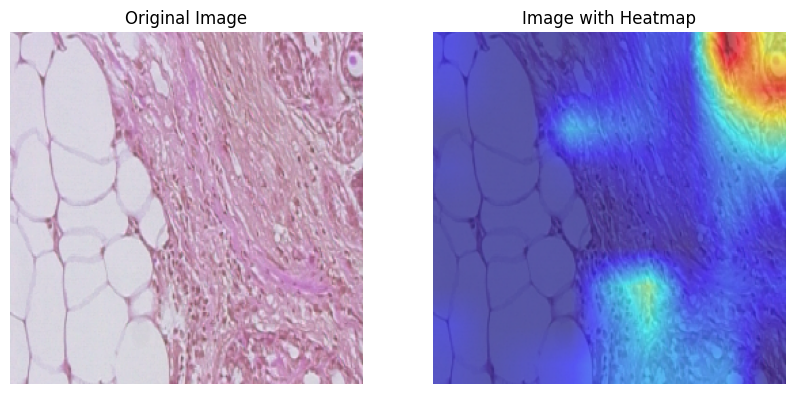

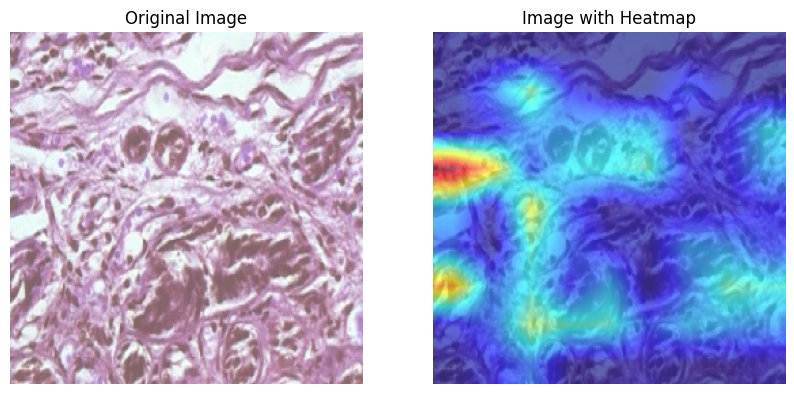

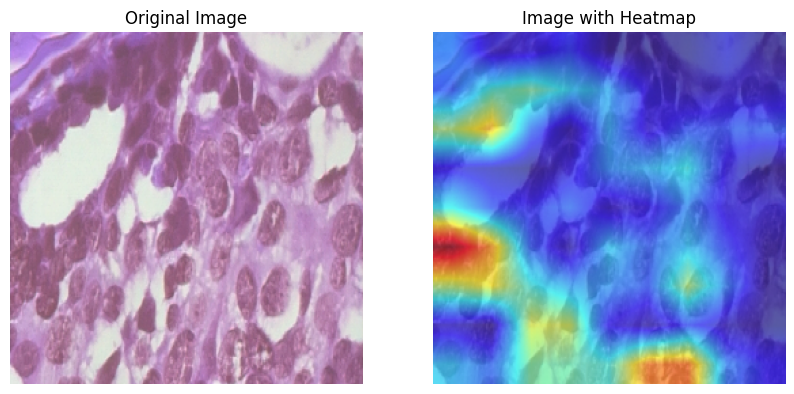

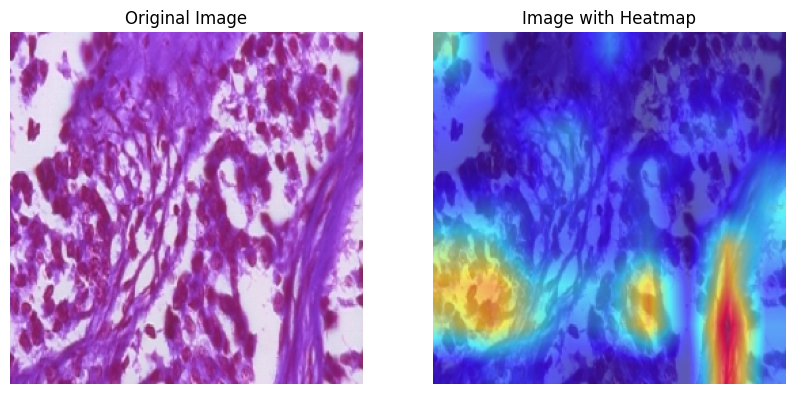

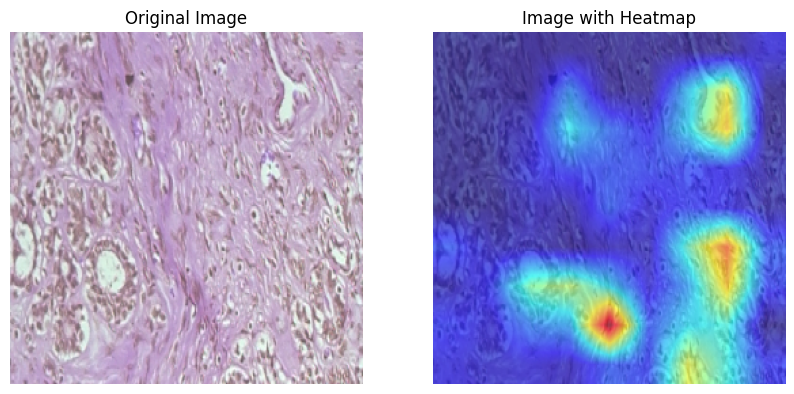

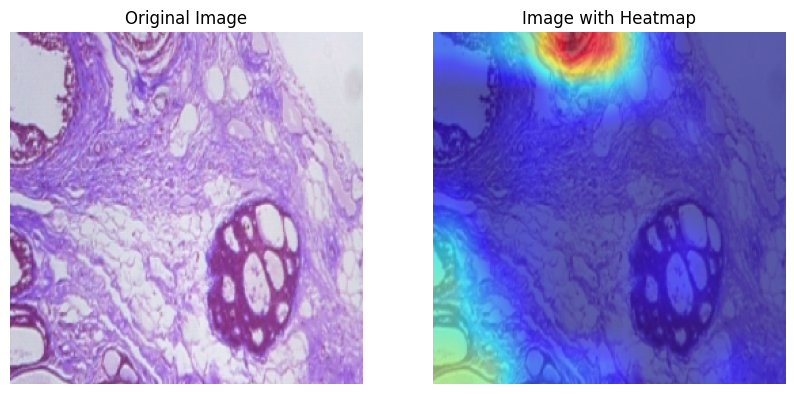

In [26]:
# with attention

for img, label in zip(X_test[:10], y_test[:10]):

    heatmap = grad_cam(EfficientNet_base_model, img, label, layer_name='top_activation')
    apply_heatmap_to_image(heatmap, img)

100%|██████████| 1/1 [00:00<00:00, 60.38it/s]


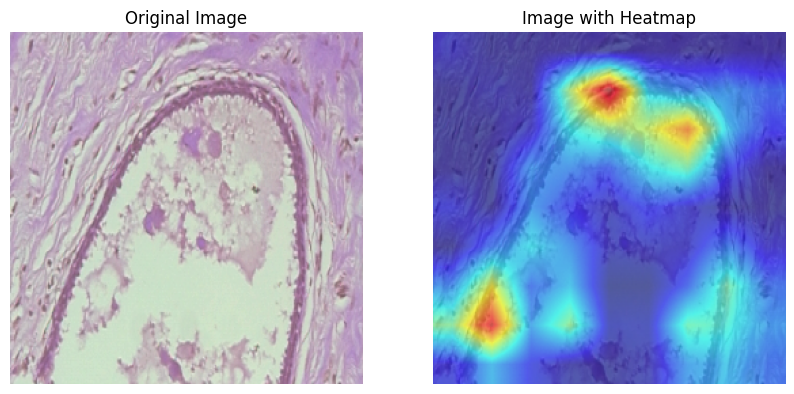

In [27]:
# a simple trial on one of the images with attention

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(EfficientNet_base_model, x, y, layer_name='top_activation')
apply_heatmap_to_image(heatmap, x)

### ResNet without attention

In [ ]:
# a simple trial on one of the images for resnet50

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(ResNet_base_model, x, y, layer_name='conv5_block3_out')
apply_heatmap_to_image(heatmap, x)

In [ ]:
# testing on 10 images

for img, label in zip(X_test[:10], y_test[:10]):

    heatmap = grad_cam(ResNet_base_model, img, label, layer_name='conv5_block3_out')
    apply_heatmap_to_image(heatmap, img)

### ResNet with attention

In [ ]:
# a simple trial on one of the images for resnet50

x, y = get_image('../input/breakhis/BreaKHis_v1/BreaKHis_v1/histology_slides/breast/benign/SOB/adenosis/SOB_B_A_14-22549AB/100X/SOB_B_A-14-22549AB-100-001.png')
heatmap = grad_cam(ResNet_base_model, x, y, layer_name='conv5_block3_out')
apply_heatmap_to_image(heatmap, x)

In [ ]:
# testing on 10 images

for img, label in zip(X_test[:10], y_test[:10]):

    heatmap = grad_cam(ResNet_base_model, img, label, layer_name='conv5_block3_out')
    apply_heatmap_to_image(heatmap, img)